# Run & display stats

In [1]:
import gc
import os
import datetime
import numpy as np
import scipy.stats as st
import pandas as pd
import openpyxl

from tqdm.notebook import tqdm

from sim import FunctionType, DistributionType, Simulation, StaticSimulation, SimulationResults, LinearSimulation, \
                LinearRandFixSimulationStatic, LinearFixedSimulationStatic, LinearSimulationStatic, SimulationEnsemble, \
                LongstepRandFixSimulationStatic, LongstepFixedSimulationStatic

from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph, CliqueOfCliquesGraph
from rw_utils import pickle_obj
from utils import print_graph, intersect, merge_sim
from db import SimulationDatabase, SimulationDirectory

In [3]:
num_nodes = 500
#nums_edges = [460, 360, 370, 280]
graph_types = [GraphType.roc, GraphType.ringClusters, GraphType.twoLevelEr, GraphType.ringRings, GraphType.cliqueOfCliques]

# Для Равномерного и случайного распределения
graphs = {
    # (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.024, 'probability_2': 0.001}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.1}),
    # (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 4, 'clique_size_2': 6, "rand": False}),
}

# (GraphType): Graph
# graphs = {
#     # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
#     (GraphType.roc): (RocGraph, {'num_cliques': 10, 'clique_size': 50}),
#     (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.2}),
#     (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 50, 'probability_1': 0.2, 'probability_2': 0.02}),
#     (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.2}),
#     (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 10, 'clique_size_2': 50, "rand": False}),
# }

# (FunctionType, DistributionType, static): Simulation
simulations = {
    # (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    # (FunctionType.linear, DistributionType.fixedOneCluster, True): LinearFixedSimulationStatic,
    # (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
    (FunctionType.longstep, DistributionType.randFix, True): LongstepRandFixSimulationStatic,
    (FunctionType.longstep, DistributionType.fixedOneCluster, True): LongstepFixedSimulationStatic,
    (FunctionType.longstep, DistributionType.fixedAllCluster, True): LongstepFixedSimulationStatic,
}



In [43]:
num_runs = 10
# params = {
#     'graph': None,
#     'count_vert': 10,
#     'isOneCluster': None,
#     'clusters_vert': None,
#     'beta_0': 0.055,
#     'beta_1': 0.0205,
#     'alpha_0': 0.0,
#     'alpha_1': 0.0,
#     'X': np.array([[.16666, 0.7], [.2, 1.0]]),
#     'max_num_iter': 500_000,
#     'is_uncomplete': False
# }
# params = {
#     'graph': None,
#     'count_vert': 10,
#     'isOneCluster': None,
#     'clusters_vert': None,
#     'beta_0': 0.055,
#     'beta_1': 0.034,
#     'alpha_0': 0.0,
#     'alpha_1': 0.0,
#     'X': np.array([[.16666, 0.5], [.2, 1.0]]),
#     'max_num_iter': 100_000,
#     'is_uncomplete': False
# }

# Two Lever
# params = {
#     'graph': None,
#     'count_vert': 10,
#     'isOneCluster': None,
#     'clusters_vert': None,
#     'beta_0': 1.0,
#     'beta_1': 1.0,
#     'alpha_0': 0.0,
#     'alpha_1': 0.0,
#     'X': np.array([[.13, 0.6], [.13, 0.6]]),
#     'max_num_iter': 500_000,
#     'is_uncomplete': False
# }

# Rings clustres
params = {
    'graph': None,
    'count_vert': 10,
    'isOneCluster': None,
    'clusters_vert': None,
    'beta_0': 1.0,
    'beta_1': 1.0,
    'alpha_0': 0.0,
    'alpha_1': 0.0,
    'X': np.array([[.014, .999], [.014, .999]]),
    'max_num_iter': 500_000,
    'is_uncomplete': False
}

## Run

In [44]:
for i in range(1):
    print(i + 1)
    for (graph_type), (graph_class, graph_params) in graphs.items():
        params['graph'] = graph_class(**graph_params)
        degrees = [val for (node, val) in params['graph'].graph.degree()]
        all_degrees = set(degrees)
        save = {deg:degrees.count(deg) for deg in all_degrees}
        print(save)
        print(sum(save.get(i, 0) for i in range(1,6)))
        if (params['graph'].graph_type == GraphType.roc or
            params['graph'].graph_type == GraphType.ringClusters or
            params['graph'].graph_type == GraphType.twoLevelEr or
            params['graph'].graph_type == GraphType.ringRings or 
            params['graph'].graph_type == GraphType.cliqueOfCliques):
    
            tmp = params['graph'].generate_clusters_node()
            params['clusters_vert'] = tmp
            
        for (func_type, distribution_type, static), simulation_class in simulations.items():
            if (params['graph'].graph_type == GraphType.roc or
                params['graph'].graph_type == GraphType.ringClusters or
                params['graph'].graph_type == GraphType.twoLevelEr or
                params['graph'].graph_type == GraphType.ringRings or 
                params['graph'].graph_type == GraphType.cliqueOfCliques):
                
                params['isOneCluster'] = (distribution_type == DistributionType.fixedOneCluster)
            
            sim = simulation_class(**params)
            sim_ensemble = SimulationEnsemble(sim, num_runs)
            sim_ensemble.run(f"test_test_test")

1
{2: 1, 3: 16, 4: 47, 5: 74, 6: 87, 7: 92, 8: 83, 9: 44, 10: 27, 11: 16, 12: 8, 13: 1, 14: 2, 15: 1, 16: 1}
138


LongstepRandFixSimulationStatic (randfix) on ringclusters(n=500,m=10,p=0.1) (1724 edges): 100%|██████████████| 10/10 [00:00<00:00, 23.26it/s]
LongstepFixedSimulationStatic (fixedonecluster) on ringclusters(n=500,m=10,p=0.1) (1724 edges): 100%|████████| 10/10 [00:02<00:00,  4.60it/s]
LongstepFixedSimulationStatic (fixedallcluster) on ringclusters(n=500,m=10,p=0.1) (1724 edges): 100%|████████| 10/10 [00:00<00:00, 18.04it/s]


## Params for all simulations

In [6]:
num_nodes = 200
num_runs = 50

params = {
    'graph': None,
    'count_vert': None,
    'isOneCluster': None,
    'clusters_vert': None,
    'beta_0': None,
    'beta_1': None,
    'alpha_0': 0.0,
    'alpha_1': 0.0,
    'max_num_iter': 1_000_000,
    'is_uncomplete': False
}

b0s = [0.055]
b1s = [0.01, 0.05, 0.055]
count_verts = [
    [8, 20, 28, 40, 48],
    [8, 20, 28, 40, 48],
    [8, 16, 24]
]

graphs_arr = [
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 4, 'clique_size': 50}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 4, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 100, 'probability_1': 0.05, 'probability_2': 0.005}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 4, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 4, 'clique_size_2': 50, "rand": False}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 4, 'random_nodes': True, 'probability': 0.3}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 100, 'probability_1': 0.5, 'probability_2': 0.05}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 4, 'probability': 0.3}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 8, 'clique_size': 25}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 25, 'num_clusters': 8, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 25, 'num_clusters': 8, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 8, 'clique_size_2': 25, "rand": False}),
}
]

simulations_arr = [
{
    (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    (FunctionType.linear, DistributionType.fixedOneCluster, True): LinearFixedSimulationStatic,
    (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
},
{
    (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    (FunctionType.linear, DistributionType.fixedOneCluster, True): LinearFixedSimulationStatic,
    (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
},
{
    (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
}]

count_sim = 50
have_merge = True

## Run All Simulations

In [68]:
num_nodes = 500
num_runs = 200

params = {
    'graph': None,
    'count_vert': None,
    'isOneCluster': None,
    'clusters_vert': None,
    'beta_0': None,
    'beta_1': None,
    'alpha_0': 0.0,
    'alpha_1': 0.0,
    'max_num_iter': 1_000_000,
    'is_uncomplete': False
}

b0s = [0.055]
b1s = [0.01, 0.05, 0.055]
count_verts = [
    [10, 20, 30, 40, 50],
    [10, 20, 30, 40, 50],
    [20, 40, 60]
]

graphs_arr = [
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 10, 'clique_size': 50}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.03, 'probability_2': 0.001}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 10, 'clique_size_2': 50, "rand": False}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.3}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.3, 'probability_2': 0.01}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.3}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 20, 'clique_size': 25}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 25, 'num_clusters': 20, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 25, 'num_clusters': 20, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 20, 'clique_size_2': 25, "rand": False}),
}
]

simulations_arr = [
{
    (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    (FunctionType.linear, DistributionType.fixedOneCluster, True): LinearFixedSimulationStatic,
    (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
},
{
    (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    (FunctionType.linear, DistributionType.fixedOneCluster, True): LinearFixedSimulationStatic,
    (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
},
{
    (FunctionType.linear, DistributionType.randFix, True): LinearRandFixSimulationStatic,
    (FunctionType.linear, DistributionType.fixedAllCluster, True): LinearFixedSimulationStatic,
}]

count_sim = 1
have_merge = False

for cur in range(3):
    for b0 in b0s:
        params["beta_0"] = b0
        for b1 in b1s:
            params["beta_1"] = b1
            for count_vert in count_verts[cur]:
                params["count_vert"] = count_vert
                dir_path = f"{cur + 3}\\n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}"
                for ind in range(count_sim):
                    print(ind + 1)
                    save_graph_name = {}
                    for (graph_type), (graph_class, graph_params) in graphs_arr[cur].items():
                        params['graph'] = graph_class(**graph_params)
                        save_graph_name[f"{graph_type}"] = params['graph'].name
                        
                        if (params['graph'].graph_type == GraphType.roc or
                            params['graph'].graph_type == GraphType.ringClusters or
                            params['graph'].graph_type == GraphType.twoLevelEr or
                            params['graph'].graph_type == GraphType.ringRings or 
                            params['graph'].graph_type == GraphType.cliqueOfCliques):
                            
                            params['clusters_vert'] = params['graph'].generate_clusters_node()
                            
                        for (func_type, distribution_type, static), simulation_class in simulations_arr[cur].items():
                            if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                continue
                            if (params['graph'].graph_type == GraphType.roc or
                                params['graph'].graph_type == GraphType.ringClusters or
                                params['graph'].graph_type == GraphType.twoLevelEr or
                                params['graph'].graph_type == GraphType.ringRings or 
                                params['graph'].graph_type == GraphType.cliqueOfCliques):
                                
                                params['isOneCluster'] = (distribution_type == DistributionType.fixedOneCluster)
                            
                            sim = simulation_class(**params)
                            sim_ensemble = SimulationEnsemble(sim, num_runs)
                            sim_ensemble.run(dir_path + f"\\ind_{ind}")
                if not (have_merge):
                    continue
                for (graph_type), (graph_class, graph_params) in graphs_arr[cur].items():
                    for (func_type, distribution_type, static), simulation_class in simulations_arr[cur].items():
                        if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                continue
                        merge_sim(cur_paths=["output\\" + dir_path + f"\\ind_{ind}" for ind in range(count_sim)], \
                              type_path=f"{func_type}_{distribution_type}_{save_graph_name[f"{graph_type}"]}_(count_vert={count_vert})" + "_static" * static, \
                              outpath="output\\" + dir_path)
    print(f"{cur}-----------------------------------------------------{cur}")

1


LinearRandFixSimulationStatic (randfix) on roc(k=10,l=50) (12260 edges):  98%|████████████████████████████▍| 196/200 [00:19<00:00, 10.23it/s]


KeyboardInterrupt: 

## Run All Simulations (Update)

In [78]:


for cur in range(3):
    for ind in range(count_sim):
        print(ind + 1)
        save_graph_name = {}
        for (graph_type), (graph_class, graph_params) in graphs_arr[cur].items():
            params['graph'] = graph_class(**graph_params)
            save_graph_name[f"{graph_type}"] = params['graph'].name
            
            if (params['graph'].graph_type == GraphType.roc or
                params['graph'].graph_type == GraphType.ringClusters or
                params['graph'].graph_type == GraphType.twoLevelEr or
                params['graph'].graph_type == GraphType.ringRings or 
                params['graph'].graph_type == GraphType.cliqueOfCliques):
                
                params['clusters_vert'] = params['graph'].generate_clusters_node()
                
            for (func_type, distribution_type, static), simulation_class in simulations_arr[cur].items():
                for b0 in b0s:
                    params["beta_0"] = b0
                    for b1 in b1s:
                        params["beta_1"] = b1
                        for count_vert in count_verts[cur]:
                            params["count_vert"] = count_vert
                            dir_path = f"{cur + 3}\\n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}"
                            
                            if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                continue
                            if (params['graph'].graph_type == GraphType.roc or
                                params['graph'].graph_type == GraphType.ringClusters or
                                params['graph'].graph_type == GraphType.twoLevelEr or
                                params['graph'].graph_type == GraphType.ringRings or 
                                params['graph'].graph_type == GraphType.cliqueOfCliques):
                                
                                params['isOneCluster'] = (distribution_type == DistributionType.fixedOneCluster)
                            
                            sim = simulation_class(**params)
                            sim_ensemble = SimulationEnsemble(sim, num_runs)
                            sim_ensemble.run(dir_path + f"\\ind_{ind}")
                            
    print(f"{cur}-----------------------------------------------------{cur}")

if have_merge:
    for cur in range(3):
        for b0 in b0s:
            for b1 in b1s:
                for count_vert in count_verts[cur]:
                    dir_path = f"{cur + 3}\\n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}"
                    for (graph_type), (graph_class, graph_params) in graphs_arr[cur].items():
                        for (func_type, distribution_type, static), simulation_class in simulations_arr[cur].items():
                            if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                    continue
                            merge_sim(cur_paths=["output\\" + dir_path + f"\\ind_{ind}" for ind in range(count_sim)], \
                                  type_path=f"{func_type}_{distribution_type}_{save_graph_name[f"{graph_type}"]}_(count_vert={count_vert})" + "_static" * static, \
                                  outpath="output\\" + dir_path)

30


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 33.74it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.70it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.62it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.24it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 88.31it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:06<00:00,  7.54it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 26.24it/s]
Linear

(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 63.46it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 71.12it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 72.75it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 78.50it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 87.71it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.77it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:01<00:00, 26.62it/s]
Linear

31


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 35.53it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 79.91it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 81.56it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.32it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 94.12it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:07<00:00,  7.08it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 31.60it/s]
Linear

(1) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 56.10it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 67.59it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 70.90it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 72.70it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 75.21it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.81it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:01<00:00, 27.38it/s]
Linear

32


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 41.53it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 71.43it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 78.52it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.55it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 91.12it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:07<00:00,  6.50it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 25.29it/s]
Linear

(1) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:00<00:00, 60.80it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:00<00:00, 68.48it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:00<00:00, 73.90it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:00<00:00, 76.01it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:00<00:00, 84.59it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.57it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (550 edges): 100%|███████████████| 50/50 [00:01<00:00, 26.17it/s]
Linear

33


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 30.28it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 76.15it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 80.04it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.59it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 88.48it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:08<00:00,  5.68it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 25.50it/s]
Linear

(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:01<00:00, 45.63it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:00<00:00, 59.66it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:00<00:00, 63.31it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:00<00:00, 72.39it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:00<00:00, 77.55it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:03<00:00, 15.52it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (515 edges): 100%|███████████████| 50/50 [00:02<00:00, 24.20it/s]
Linear

34


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 36.01it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 83.46it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.74it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 93.42it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 91.79it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:10<00:00,  4.77it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 29.51it/s]
Linear

(1) Create
(2) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:00<00:00, 64.19it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:00<00:00, 71.46it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:00<00:00, 74.54it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:00<00:00, 78.39it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:00<00:00, 84.17it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.33it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (562 edges): 100%|███████████████| 50/50 [00:01<00:00, 25.62it/s]
Linear

35


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 33.17it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.89it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 79.00it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 86.25it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 74.19it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:07<00:00,  6.80it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 28.04it/s]
Linear

(1) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:00<00:00, 62.13it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:00<00:00, 71.38it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:00<00:00, 79.63it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:00<00:00, 79.63it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:00<00:00, 90.96it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:02<00:00, 19.56it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (565 edges): 100%|███████████████| 50/50 [00:01<00:00, 27.66it/s]
Linear

36


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 46.30it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 71.10it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.29it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.31it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.17it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:12<00:00,  3.94it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 27.14it/s]
Linear

(2) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 60.09it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 66.93it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 73.02it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 80.58it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:00<00:00, 83.61it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.04it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (535 edges): 100%|███████████████| 50/50 [00:01<00:00, 26.76it/s]
Linear

37


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 41.32it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 82.50it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 81.76it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.18it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 92.54it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:07<00:00,  6.37it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 27.74it/s]
Linear

(1) Create
(1) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 59.37it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 69.62it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 74.76it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 83.87it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 84.43it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.86it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:01<00:00, 27.94it/s]
Linear

38


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 42.22it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 70.16it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 89.91it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 91.09it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 92.73it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:06<00:00,  8.14it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 30.19it/s]
Linear

(1) Create
(1) Create
(1) Create
(1) Create
(1) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:00<00:00, 68.01it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:00<00:00, 73.67it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:00<00:00, 76.59it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:00<00:00, 86.40it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:00<00:00, 89.42it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:02<00:00, 20.18it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (607 edges): 100%|███████████████| 50/50 [00:01<00:00, 28.97it/s]
Linear

39


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 33.93it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 75.90it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 87.78it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 90.60it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 98.06it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:08<00:00,  5.64it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 28.78it/s]
Linear

(1) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:00<00:00, 63.90it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:00<00:00, 74.21it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:00<00:00, 79.56it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:00<00:00, 84.66it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:00<00:00, 50.66it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:02<00:00, 18.73it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (569 edges): 100%|███████████████| 50/50 [00:01<00:00, 28.57it/s]
Linear

40


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 46.63it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 79.63it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 80.65it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 96.66it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 92.89it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:09<00:00,  5.54it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 30.44it/s]
Linear

(1) Create
(1) Create
(2) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:00<00:00, 60.94it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:00<00:00, 66.95it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:00<00:00, 71.24it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:00<00:00, 79.68it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:00<00:00, 77.70it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.19it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (573 edges): 100%|███████████████| 50/50 [00:01<00:00, 26.64it/s]
Linear

41


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 41.35it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.68it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 82.07it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.90it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 94.91it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:06<00:00,  7.18it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:02<00:00, 21.73it/s]
Linear

42


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 38.96it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 80.13it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 88.15it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 95.19it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 94.30it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:06<00:00,  7.15it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 26.30it/s]
Linear

(2) Create
(2) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 65.84it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 79.06it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 77.84it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 84.74it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:00<00:00, 92.81it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:02<00:00, 18.49it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (557 edges): 100%|███████████████| 50/50 [00:01<00:00, 28.17it/s]
Linear

43


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 42.86it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 67.21it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.56it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 86.99it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.19it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:10<00:00,  4.62it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 28.34it/s]
Linear

(1) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:00<00:00, 61.02it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:00<00:00, 72.39it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:00<00:00, 75.66it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:00<00:00, 80.31it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:00<00:00, 86.95it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:02<00:00, 18.33it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (608 edges): 100%|███████████████| 50/50 [00:01<00:00, 28.70it/s]
Linear

44


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 33.99it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 75.49it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.10it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 78.34it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.96it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:07<00:00,  6.69it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 27.01it/s]
Linear

(1) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:00<00:00, 61.55it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:00<00:00, 71.16it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:00<00:00, 73.24it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:00<00:00, 77.68it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:00<00:00, 83.20it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:02<00:00, 17.87it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (513 edges): 100%|███████████████| 50/50 [00:01<00:00, 27.76it/s]
Linear

45


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 42.42it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 77.66it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 83.20it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.11it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 89.16it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:08<00:00,  5.75it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 29.75it/s]
Linear

(1) Create
(1) Create
(1) Create
(1) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 62.59it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 73.45it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 78.42it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 80.40it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:00<00:00, 82.58it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:02<00:00, 19.17it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (552 edges): 100%|███████████████| 50/50 [00:01<00:00, 26.42it/s]
Linear

46


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 31.61it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 70.36it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 86.50it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 91.05it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 95.38it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:06<00:00,  7.58it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 30.50it/s]
Linear

(1) Create
(1) Create
(1) Create
(1) Create
(1) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:00<00:00, 64.15it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:00<00:00, 73.45it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:00<00:00, 75.90it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:00<00:00, 83.89it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:00<00:00, 89.11it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:02<00:00, 16.83it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (504 edges): 100%|███████████████| 50/50 [00:01<00:00, 27.49it/s]
Linear

47


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 36.14it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 81.05it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.60it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 93.42it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 96.11it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:09<00:00,  5.33it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 28.09it/s]
Linear

48


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 29.70it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 81.44it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 85.46it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 97.22it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 93.60it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:05<00:00,  8.83it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 27.41it/s]
Linear

49


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 37.24it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 84.46it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 90.88it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 97.22it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|████████████████████████████████| 50/50 [00:00<00:00, 104.30it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:07<00:00,  6.97it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 28.20it/s]
Linear

(1) Create
(1) Create
(1) Create
(1) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:00<00:00, 69.10it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:00<00:00, 79.00it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:00<00:00, 81.04it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:00<00:00, 91.38it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:00<00:00, 94.47it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:02<00:00, 20.57it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (564 edges): 100%|███████████████| 50/50 [00:01<00:00, 32.67it/s]
Linear

50


LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 36.46it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 83.89it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 93.25it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:00<00:00, 99.34it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|████████████████████████████████| 50/50 [00:00<00:00, 106.51it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:08<00:00,  6.21it/s]
LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50) (4904 edges): 100%|█████████████████████████████████| 50/50 [00:01<00:00, 32.30it/s]
Linear

(2) Create
(2) Create


LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:00<00:00, 71.16it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:00<00:00, 81.04it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:00<00:00, 88.17it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:00<00:00, 90.07it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:00<00:00, 94.48it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:02<00:00, 21.61it/s]
LinearRandFixSimulationStatic (randfix) on twoleveler(n=200,p=0.05,q=0.005) (534 edges): 100%|███████████████| 50/50 [00:01<00:00, 33.03it/s]
Linear

0-----------------------------------------------------0


## Display stats

In [4]:
path_dir = f'output\\merge_new_new\\merge'

table_dict = {}
table_dict['Graph Type'] = []

cnt = 0
for (_, distribution_type, _), _ in simulations.items():
    table_dict[f"{distribution_type}_l"] = []
    table_dict[f"{distribution_type}_r"] = []
    table_dict[f"{distribution_type}_E[t]"] = []
    table_dict[f"{distribution_type}_t_max"] = []
    cnt += 1

for i in range(cnt):
    for j in range(i + 1, cnt):
        table_dict[f"{i + 1}-{j + 1}"] = []

df = pd.DataFrame(table_dict)

sdb = SimulationDatabase(path=path_dir)

for (graph_type), (_, graph_params) in graphs.items():
    all_int = []
    new_row = {}
    new_row["Graph Type"] = f"{graph_type}"
    for (func_type, distribution_type, static), _ in simulations.items():
        sdirs = [
            sdir
            for sdir in sdb.sdirs
            if (sdir.sim.func_type == func_type) and
            (sdir.sim.distribution_type == distribution_type) and
            (static is isinstance(sdir.sim, StaticSimulation)) and
            (sdir.sim.graph.graph_type == graph_type)
        ]
        
        if len(sdirs) != 1:
            raise RuntimeError(f"Found {len(sdirs)} SimulationDirectories after filter. Expected over 1.")

        sdir = sdirs[0]
        
        sdir.cache()
        sdir.info()
        
        tmp_times = sdir.times[sdir.outcomes]
        
        if (len(tmp_times) > 30):
            all_int.append(st.norm.interval(confidence=0.95, loc=sdir.t_mean_1, scale=sdir.sem))
        else: 
            all_int.append(st.t.interval(confidence=0.95, df=len(tmp_times)-1, loc=sdir.t_mean_1, scale=sdir.sem))
            
        print("norm interval: ", all_int[-1])
        
        new_row[f"{distribution_type}_l"], new_row[f"{distribution_type}_r"] = all_int[-1]
        new_row[f"{distribution_type}_E[t]"] = sdir.t_mean_1
        new_row[f"{distribution_type}_t_max"] = sdir.t_max
        
        del sdir
        
        gc.collect()
    
    for i in range(len(all_int)):
        for j in range(i + 1, len(all_int)):
            if intersect(all_int[i], all_int[j]):
                new_row[f"{(i + 1)}-{(j + 1)}"] = "'='"
            elif (all_int[i][0] > all_int[j][0]):
                new_row[f"{(i + 1)}-{(j + 1)}"] = "'>'"
            else:
                new_row[f"{(i + 1)}-{(j + 1)}"] = "'<'"
    print(new_row)
    df.loc[len(df.index)] = new_row

df.to_excel(path_dir + '\\interval.xlsx')

SimulationDirectory for LongstepRandFixSimulationStatic (randfix) on twoleveler(n=500,p=0.024,q=0.001), 1545 edges (50 runs)
E[t|~A] = None
E[t|A] = 30953.86
tmax = 243469
standart_error = 8273.630838479363
norm interval:  (14737.84153520052, 47169.87846479948)
SimulationDirectory for LongstepFixedSimulationStatic (fixedonecluster) on twoleveler(n=500,p=0.024,q=0.001), 1545 edges (50 runs)
E[t|~A] = None
E[t|A] = 1586.64
tmax = 4923
standart_error = 113.39954562051285
norm interval:  (1364.380974720588, 1808.8990252794122)
SimulationDirectory for LongstepFixedSimulationStatic (fixedallcluster) on twoleveler(n=500,p=0.024,q=0.001), 1545 edges (50 runs)
E[t|~A] = None
E[t|A] = 44916.94871794872
tmax = 500001
standart_error = 13692.124916437411
norm interval:  (18080.877009907894, 71753.02042598954)
{'Graph Type': 'twoleveler', 'randfix_l': 14737.84153520052, 'randfix_r': 47169.87846479948, 'randfix_E[t]': 30953.86, 'randfix_t_max': 243469, 'fixedonecluster_l': 1364.380974720588, 'fixedon

## Display Stats LongStepFunction

In [33]:
table_dict = {}
table_dict['ind'] = []
table_dict['Graph Type'] = []

cnt = 0
for (_, distribution_type, _), _ in simulations.items():
    table_dict[f"{distribution_type}_l"] = []
    table_dict[f"{distribution_type}_r"] = []
    table_dict[f"{distribution_type}_E[t]"] = []
    table_dict[f"{distribution_type}_t_max"] = []
    cnt += 1

for i in range(cnt):
    for j in range(i + 1, cnt):
        table_dict[f"{i + 1}-{j + 1}"] = []

df_main = pd.DataFrame(table_dict)
path_dir_out = f'output\\test\\two_lever'
for ind in range(50):
    path_dir = path_dir_out + f'\\test_two_lever_{ind}'
    
    table_dict = {}
    table_dict['Graph Type'] = []
    
    cnt = 0
    for (_, distribution_type, _), _ in simulations.items():
        table_dict[f"{distribution_type}_l"] = []
        table_dict[f"{distribution_type}_r"] = []
        table_dict[f"{distribution_type}_E[t]"] = []
        table_dict[f"{distribution_type}_t_max"] = []
        cnt += 1
    
    for i in range(cnt):
        for j in range(i + 1, cnt):
            table_dict[f"{i + 1}-{j + 1}"] = []
    
    df = pd.DataFrame(table_dict)
    
    sdb = SimulationDatabase(path=path_dir)
    
    for (graph_type), (_, graph_params) in graphs.items():
        all_int = []
        new_row = {}
        new_row["Graph Type"] = f"{graph_type}"
        for (func_type, distribution_type, static), _ in simulations.items():
            sdirs = [
                sdir
                for sdir in sdb.sdirs
                if (sdir.sim.func_type == func_type) and
                (sdir.sim.distribution_type == distribution_type) and
                (static is isinstance(sdir.sim, StaticSimulation)) and
                (sdir.sim.graph.graph_type == graph_type)
            ]
            
            if len(sdirs) != 1:
                raise RuntimeError(f"Found {len(sdirs)} SimulationDirectories after filter. Expected over 1.")
    
            sdir = sdirs[0]
            
            sdir.cache()
            sdir.info()
            
            tmp_times = sdir.times
            mean = tmp_times.mean()
            sem = st.sem(tmp_times)
            
            if (len(tmp_times) > 30):
                all_int.append(st.norm.interval(confidence=0.95, loc=mean, scale=sem))
            else: 
                all_int.append(st.t.interval(confidence=0.95, df=len(tmp_times)-1, loc=mean, scale=sem))
                
            print("norm interval: ", all_int[-1])
            
            new_row[f"{distribution_type}_l"], new_row[f"{distribution_type}_r"] = all_int[-1]
            new_row[f"{distribution_type}_E[t]"] = sdir.t_mean_1
            new_row[f"{distribution_type}_t_max"] = sdir.t_max
            
            del sdir
            
            gc.collect()
        
        for i in range(len(all_int)):
            for j in range(i + 1, len(all_int)):
                if intersect(all_int[i], all_int[j]):
                    new_row[f"{(i + 1)}-{(j + 1)}"] = "'='"
                elif (all_int[i][0] > all_int[j][0]):
                    new_row[f"{(i + 1)}-{(j + 1)}"] = "'>'"
                else:
                    new_row[f"{(i + 1)}-{(j + 1)}"] = "'<'"
        print(new_row)
        df.loc[len(df.index)] = new_row
        
        
        df_main.loc[len(df_main.index)] = new_row
    
    df.to_excel(path_dir + '\\interval.xlsx')

df_main.to_excel(path_dir_out + '\\interval.xlsx')

SimulationDirectory for LongstepRandFixSimulationStatic (randfix) on twoleveler(n=500,p=0.024,q=0.001), 1587 edges (100 runs)
E[t|~A] = None
E[t|A] = 1753.19
tmax = 133191
standart_error = 1332.393941024875
norm interval:  (-858.2541376281397, 4364.63413762814)
SimulationDirectory for LongstepFixedSimulationStatic (fixedonecluster) on twoleveler(n=500,p=0.024,q=0.001), 1587 edges (100 runs)
E[t|~A] = None
E[t|A] = 39.83
tmax = 53
standart_error = 0.42806942701322914
norm interval:  (38.99099934017137, 40.669000659828626)
SimulationDirectory for LongstepFixedSimulationStatic (fixedallcluster) on twoleveler(n=500,p=0.024,q=0.001), 1587 edges (100 runs)
E[t|~A] = None
E[t|A] = 86.14
tmax = 220
standart_error = 3.990873932796518
norm interval:  (78.3180308248791, 93.9619691751209)
{'Graph Type': 'twoleveler', 'randfix_l': -858.2541376281397, 'randfix_r': 4364.63413762814, 'randfix_E[t]': 1753.19, 'randfix_t_max': 133191, 'fixedonecluster_l': 38.99099934017137, 'fixedonecluster_r': 40.66900

## Display Stats All Simulations

In [6]:
graphs_arr = [
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 10, 'clique_size': 50}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.03, 'probability_2': 0.001}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 10, 'clique_size_2': 50, "rand": False}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.3}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.3, 'probability_2': 0.01}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.3}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 20, 'clique_size': 25}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 25, 'num_clusters': 20, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 25, 'num_clusters': 20, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 20, 'clique_size_2': 25, "rand": False}),
}
]

have_merge = False

table_dict_main = {}
table_dict_main["ind"] = []
table_dict_main["n"] = []
table_dict_main["st_n"] = []
table_dict_main["b0"] = []
table_dict_main["b1"] = []
table_dict_main['Graph Type'] = []
cnt = 0

for (_, distribution_type, _), _ in simulations_arr[0].items():
    table_dict_main[f"{distribution_type}_l"] = []
    table_dict_main[f"{distribution_type}_r"] = []
    table_dict_main[f"{distribution_type}_E[t]"] = []
    table_dict_main[f"{distribution_type}_t_max"] = []
    cnt += 1

for i in range(cnt):
    for j in range(i + 1, cnt):
        table_dict_main[f"{i + 1}-{j + 1}"] = []


for cur in range(1):
    wb = openpyxl.Workbook()
    filepath = f"output//{cur + 3}//interval_all_sim.xlsx"
    wb.save(filepath)
    writer = pd.ExcelWriter(filepath, engine='openpyxl')

    df_main = pd.DataFrame(table_dict_main)
    
    for b0 in b0s:
        params["beta_0"] = b0
        for b1 in b1s:
            params["beta_1"] = b1
            for count_vert in count_verts[cur]:
                params["count_vert"] = count_vert
                path_dir_cur = f"output//{cur + 3}//n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}"
                
                for ind in range(count_sim + (1 * have_merge)):
                    print(ind + 1)
                    
                    path_dir = path_dir_cur
                    
                    if (ind != count_sim):
                        path_dir += f"//ind_{ind}"
                    else:
                        path_dir += f"//merge"
                    
                    table_dict = {}
                    table_dict['Graph Type'] = []
                    
                    cnt = 0
                    for (_, distribution_type, _), _ in simulations_arr[cur].items():
                        if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                continue
                        table_dict[f"{distribution_type}_l"] = []
                        table_dict[f"{distribution_type}_r"] = []
                        table_dict[f"{distribution_type}_E[t]"] = []
                        table_dict[f"{distribution_type}_t_max"] = []
                        cnt += 1
                    
                    for i in range(cnt):
                        for j in range(i + 1, cnt):
                            table_dict[f"{i + 1}-{j + 1}"] = []
                    
                    df = pd.DataFrame(table_dict)
                    
                    sdb = SimulationDatabase(path=path_dir)
                    print(path_dir)
                    for (graph_type), (_, graph_params) in graphs_arr[cur].items():
                        all_int = []
                        new_row = {}
                        new_row["Graph Type"] = f"{graph_type}"    
                        for (func_type, distribution_type, static), _ in simulations_arr[cur].items():
                            if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                continue
                            sdirs = [
                                sdir
                                for sdir in sdb.sdirs
                                if (sdir.sim.func_type == func_type) and
                                (sdir.sim.distribution_type == distribution_type) and
                                (static is isinstance(sdir.sim, StaticSimulation)) and
                                (sdir.sim.graph.graph_type == graph_type)
                            ]
                            
                            if len(sdirs) != 1:
                                raise RuntimeError(f"Found {len(sdirs)} SimulationDirectories after filter. Expected over 1.")
                    
                            sdir = sdirs[0]
                            
                            sdir.cache()
                            sdir.info()
                            
                            tmp_times = sdir.times[sdir.outcomes]
                            if (len(tmp_times) > 30):
                                all_int.append(st.norm.interval(confidence=0.95, loc=sdir.t_mean_1, scale=sdir.sem))
                            else: 
                                all_int.append(st.t.interval(confidence=0.95, df=len(tmp_times)-1, loc=sdir.t_mean_1, scale=sdir.sem))
        
                            print("norm interval: ", all_int[-1])
                            
                            new_row[f"{distribution_type}_l"], new_row[f"{distribution_type}_r"] = all_int[-1]
                            new_row[f"{distribution_type}_E[t]"] = sdir.t_mean_1
                            new_row[f"{distribution_type}_t_max"] = sdir.t_max
                            
                            del sdir
                            
                            gc.collect()
    
                        for i in range(len(all_int)):
                            for j in range(i + 1, len(all_int)):
                                if intersect(all_int[i], all_int[j]):
                                    new_row[f"{(i + 1)}-{(j + 1)}"] = "'='"
                                elif (all_int[i][0] > all_int[j][0]):
                                    new_row[f"{(i + 1)}-{(j + 1)}"] = "'>'"
                                else:
                                    new_row[f"{(i + 1)}-{(j + 1)}"] = "'<'"
                        
                        df.loc[len(df.index)] = new_row

                        new_row["ind"] = ind
                        new_row["n"] = num_nodes
                        new_row["st_n"] = count_vert
                        new_row["b0"] = b0
                        new_row["b1"] = b1
                        
                        df_main.loc[len(df_main.index)] = new_row
                    df.to_excel(path_dir + '\\interval.xlsx', sheet_name=f"n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}")
                    
                    df.to_excel(writer, sheet_name=f"n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}", index=False)
                    
                    
    df_main.to_excel(writer, sheet_name=f"All params", index=False)
    writer.close()
    print(f"{cur}-----------------------------------------------------{cur}")

1
output//3//n=200 st_n=8 b0=0.055_b1=0.01//ind_0
SimulationDirectory for LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50), 4904 edges (50 runs)
E[t|~A] = None
E[t|A] = 428.86
tmax = 2007
standart_error = 67.1354768588205
norm interval:  (297.27688327178964, 560.4431167282104)
SimulationDirectory for LinearFixedSimulationStatic (fixedonecluster) on roc(k=4,l=50), 4904 edges (50 runs)
E[t|~A] = None
E[t|A] = 2215.26
tmax = 5984
standart_error = 148.35647309842628
norm interval:  (1924.4866558536992, 2506.0333441463013)
SimulationDirectory for LinearFixedSimulationStatic (fixedallcluster) on roc(k=4,l=50), 4904 edges (50 runs)
E[t|~A] = None
E[t|A] = 202.28
tmax = 278
standart_error = 3.926782969530646
norm interval:  (194.5836468046147, 209.97635319538531)
SimulationDirectory for LinearRandFixSimulationStatic (randfix) on ringclusters(n=200,m=4,p=0.1), 709 edges (50 runs)
E[t|~A] = None
E[t|A] = 219.2
tmax = 319
standart_error = 4.982499987200098
norm interval:  (209.43447947211

# Plot & animate

In [3]:
import os
import gc
import numpy as np
from matplotlib import pyplot as plt

from sim import FunctionType, StaticSimulation, FixedSimulation, RandFixSimulation, FunctionType
from graph import GraphType, RocGraph
from plot import SigmaPlot
from db import SimulationDatabase, SimulationDirectory
from utils import sigma_mean, sigmas, pad
from rw_utils import read_pickled, deserialize_boolean_array
from animate import animate

%matplotlib inline

In [8]:
color = {
    GraphType.roc: 'red',
    GraphType.ringClusters: 'green',
    GraphType.twoLevelEr: 'blue',
    GraphType.ringRings: 'yellow',
}

x_right = {
    FunctionType.linear: 2500
}

label = {
    GraphType.roc: 'кольцо клик',
    GraphType.ringClusters: 'регулярное кольцо с "городами"',
    GraphType.twoLevelEr: 'двухуровневый Эрдеша-Реньи',
    GraphType.ringRings: 'Кольцо 2-регулярных колец'
}

## Plot all

twoleveler_b0=1.0_b1=1.0_p=0.024_q=0.001_count_static=10_static.png:
caching SimulationDirectory for LongstepFixedSimulationStatic (fixedonecluster) on twoleveler(n=500,p=0.024,q=0.001), 1581 edges (100 runs)...



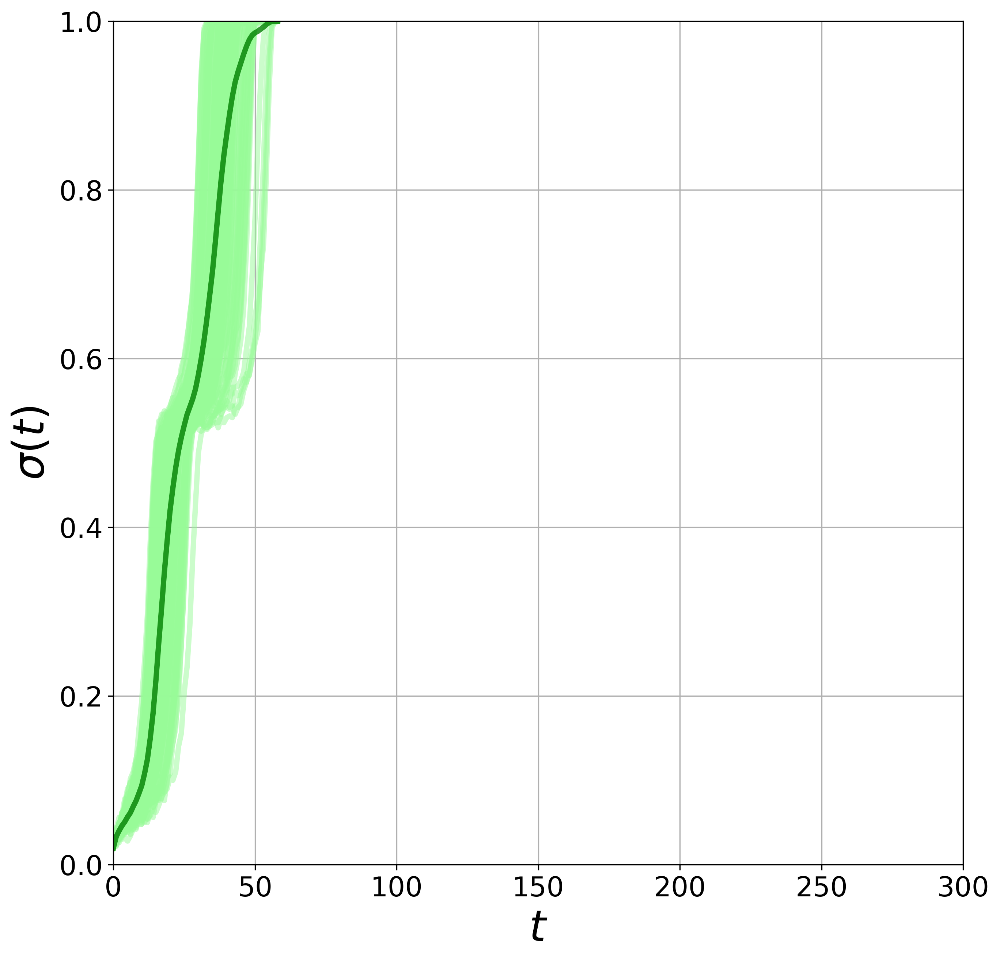

In [6]:

color_my = {
    DistributionType.randFix: 'red',
    DistributionType.fixedOneCluster: 'green',
    DistributionType.fixedAllCluster: 'blue'
}

color_sim = {
    DistributionType.randFix: '#CD5C5C',
    DistributionType.fixedOneCluster: '#98FB98',
    DistributionType.fixedAllCluster: '#77DDE7'
}

label_my = {
    DistributionType.randFix: 'Случайно в графе',
    DistributionType.fixedOneCluster: 'в одном городе',
    DistributionType.fixedAllCluster: 'во всех городах поровну'
}
statics = [
    True
]

func_types = [
    # FunctionType.linear,
    FunctionType.longstep
]

distribution_types = [
    DistributionType.randFix,
    DistributionType.fixedOneCluster,
    DistributionType.fixedAllCluster
]

graph_types = [
    # GraphType.roc,
    # GraphType.ringClusters,
    GraphType.twoLevelEr,
    # GraphType.cliqueOfCliques,
    # GraphType.ringRings
]

x_right_static = [300]


for ind in range(1):
    path_dir = f'test\\two_lever\\test_two_lever_{19}'
    sdb = SimulationDatabase(path=f'output\\' + path_dir)
    for static in statics:
        for func_type in func_types:
            for graph_type in graph_types:
                sdirs = [
                    sdir
                    for sdir in sdb.sdirs
                    if (sdir.sim.func_type == func_type) and
                    (static is isinstance(sdir.sim, StaticSimulation)) and
                    (sdir.sim.graph.graph_type != GraphType.complete) and
                    (sdir.sim.graph.graph_type == graph_type) and
                    (DistributionType.fixedOneCluster == sdir.sim.distribution_type)
                ]
                
                if len(sdirs) != 1 and len(sdirs) != 3:
                    raise RuntimeError(f"Expected 2 or 3 SimulationDirectories after filter, got {len(sdirs)}.")
                sim = sdirs[0].sim
                
                fname = f"{sim.graph.graph_type}_b0={sim.beta_0}_b1={sim.beta_1}"
                
                if (sim.graph.graph_type == GraphType.twoLevelEr):
                    fname += f"_p={sim.graph.probability_1}_q={sim.graph.probability_2}"
                elif (sim.graph.graph_type == GraphType.roc):
                    fname += f"_n_cliq={sim.graph.num_cliques}_cliq_s={sim.graph.clique_size}"
                elif (sim.graph.graph_type == GraphType.ringClusters):
                    fname += f"_clus_s={sim.graph.num_nodes_cluster}_n_clus={sim.graph.num_clusters}_p={sim.graph.probability}"
                elif (sim.graph.graph_type == GraphType.ringRings):
                    fname += f"_clus_s={sim.graph.num_nodes_cluster}_n_clus={sim.graph.num_clusters}_p={sim.graph.probability}"
                elif (sim.graph.graph_type == GraphType.ringRings):
                    fname += f"_cliq_s_1={sim.graph.clique_size_1}_cliq_s_2={sim.graph.clique_size_2}"
    
                if isinstance(sim, FixedSimulation) or isinstance(sim, RandFixSimulation):
                    fname += f"_count_static={sim.count_vert}"
                fname += "_static" * static + ".png"
                
                print(f"{fname}:")
                splot = SigmaPlot(linewidth=3.5, alpha=.8, ax_tick_size=18, ax_label_size=28)
                
                gc.collect()
                
                for sdir in sdirs:
                    print(f'caching {sdir}...')
                    sdir.cache()
                print()
                x_max = max([sdir.t_max for sdir in sdirs])
                
                for sdir in sdirs:
                    
                    sdir.cache()
                    
                    # tmp = [sdir.state_histories[50 * j: 50 * (j + 1)] for j in range(50)]
                    
                    for state in sdir.state_histories[:]:
                        sigma_avg = sigma_mean([state], pad_to=x_max)
                        
                        splot.ax.plot(
                            range(len(sigma_avg)),
                            sigma_avg,
                            color=color_sim[sdir.sim.distribution_type],
                            alpha=0.5,
                            linewidth=splot.linewidth,
                            ls=splot.linestyle,
                            label=label_my[sdir.sim.distribution_type]
                        )
                        
                for sdir in sdirs:
                    splot.plot(sdir, color=color_my[sdir.sim.distribution_type], x_max=x_max, label=label_my[sdir.sim.distribution_type])
                
                if not os.path.isdir('plots\\' + path_dir):
                    os.makedirs('plots\\' + path_dir, exist_ok=True)
                
                for xright in x_right_static:
                    splot.update_axlims(x_right=xright)
                
                    # save
                    splot.fig.savefig(
                        os.path.join('plots\\' + path_dir, "tmp_" + f"({xright})" + fname),
                        bbox_inches='tight',
                        pad_inches=0
                    )
                    # display
                    # display(splot.fig)

## Plot all for simulations

roc_b0=0.055_b1=0.01_n_cliq=4_cliq_s=50_count_static=8_static.png:
caching SimulationDirectory for LinearFixedSimulationStatic (fixedallcluster) on roc(k=4,l=50), 4904 edges (2500 runs)...
caching SimulationDirectory for LinearFixedSimulationStatic (fixedonecluster) on roc(k=4,l=50), 4904 edges (2500 runs)...
caching SimulationDirectory for LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50), 4904 edges (2500 runs)...

ringclusters_b0=0.055_b1=0.01_clus_s=50_n_clus=4_p=0.1_count_static=8_static.png:
caching SimulationDirectory for LinearFixedSimulationStatic (fixedallcluster) on ringclusters(n=200,m=4,p=0.1), 694 edges (2500 runs)...
caching SimulationDirectory for LinearFixedSimulationStatic (fixedonecluster) on ringclusters(n=200,m=4,p=0.1), 694 edges (2500 runs)...
caching SimulationDirectory for LinearRandFixSimulationStatic (randfix) on ringclusters(n=200,m=4,p=0.1), 694 edges (2500 runs)...

twoleveler_b0=0.055_b1=0.01_p=0.05_q=0.005_count_static=8_static.png:
caching Simula

F:\VKR\Gevo\plot.py:63: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  self.fig, self.ax = plt.subplots(figsize=self._figsize, dpi=self._dpi)


caching SimulationDirectory for LinearFixedSimulationStatic (fixedallcluster) on roc(k=4,l=50), 4904 edges (2500 runs)...
caching SimulationDirectory for LinearFixedSimulationStatic (fixedonecluster) on roc(k=4,l=50), 4904 edges (2500 runs)...
caching SimulationDirectory for LinearRandFixSimulationStatic (randfix) on roc(k=4,l=50), 4904 edges (2500 runs)...

ringclusters_b0=0.055_b1=0.01_clus_s=50_n_clus=4_p=0.1_count_static=48_static.png:
caching SimulationDirectory for LinearFixedSimulationStatic (fixedallcluster) on ringclusters(n=200,m=4,p=0.1), 694 edges (2500 runs)...
caching SimulationDirectory for LinearFixedSimulationStatic (fixedonecluster) on ringclusters(n=200,m=4,p=0.1), 694 edges (2500 runs)...
caching SimulationDirectory for LinearRandFixSimulationStatic (randfix) on ringclusters(n=200,m=4,p=0.1), 694 edges (2500 runs)...

twoleveler_b0=0.055_b1=0.01_p=0.05_q=0.005_count_static=48_static.png:
caching SimulationDirectory for LinearFixedSimulationStatic (fixedallcluster) o

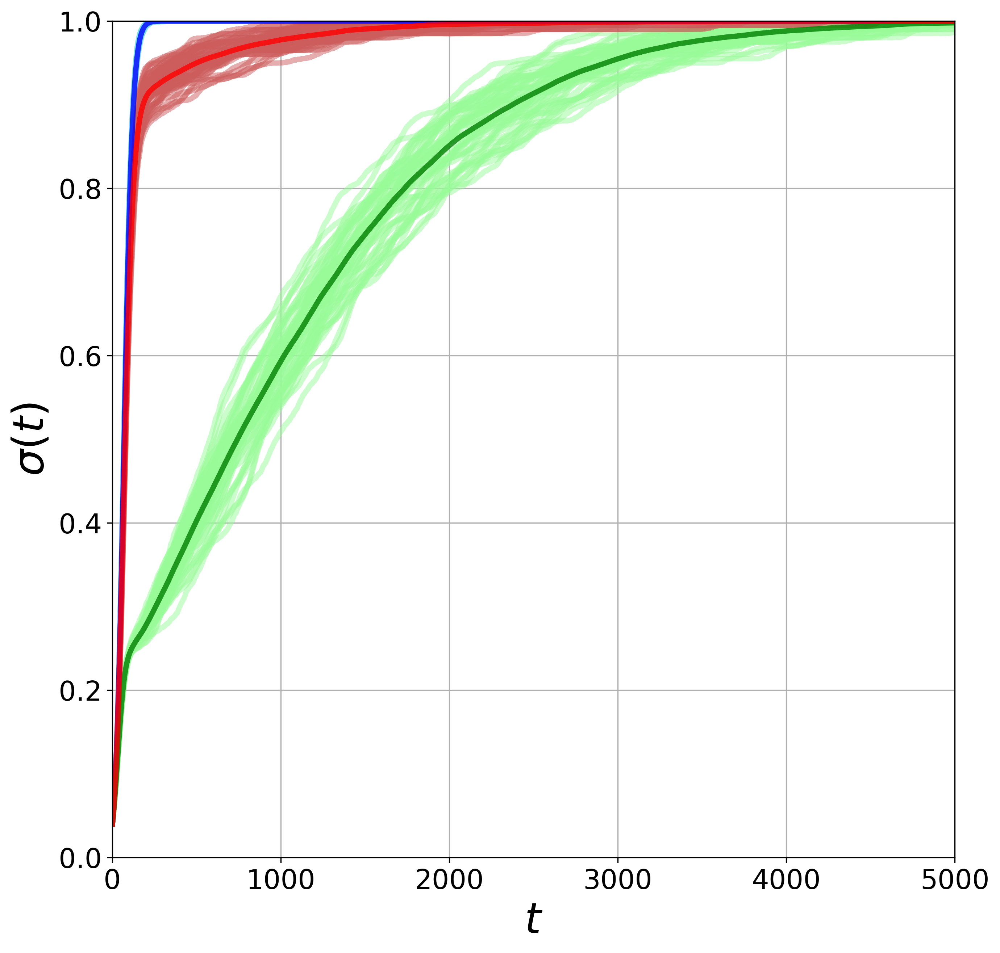

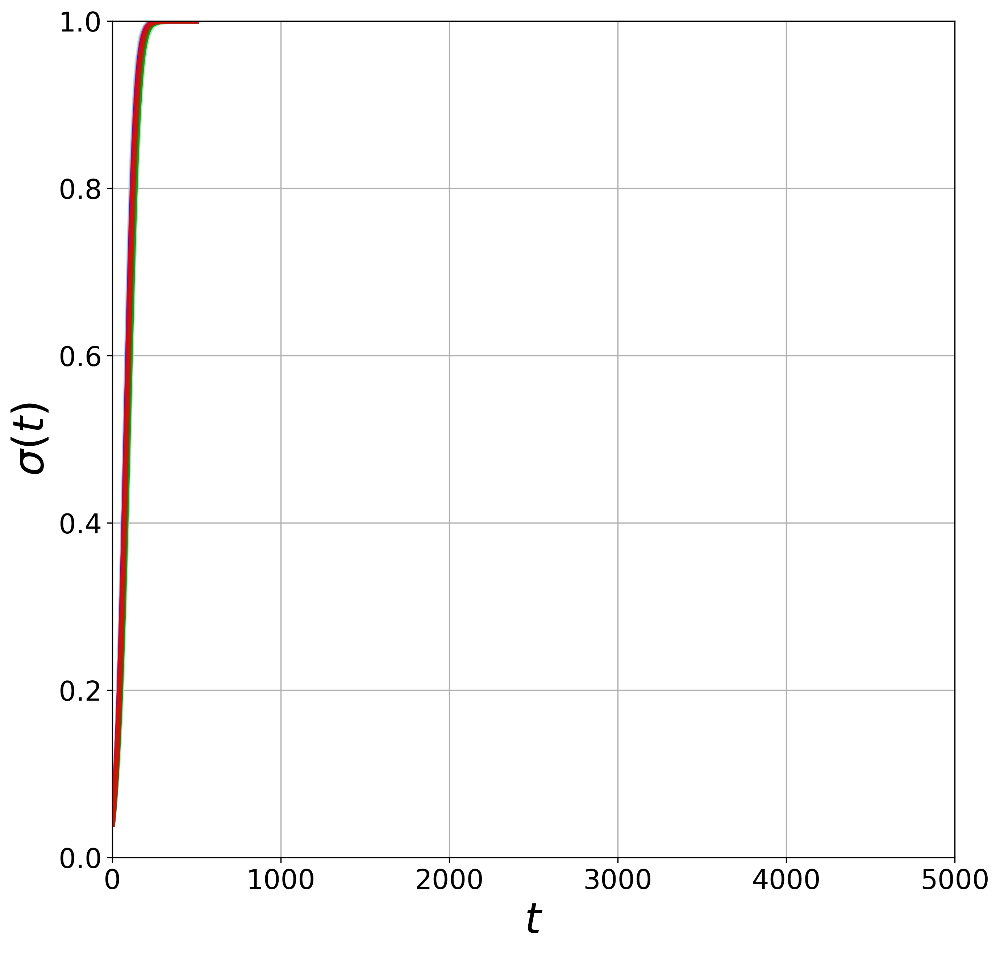

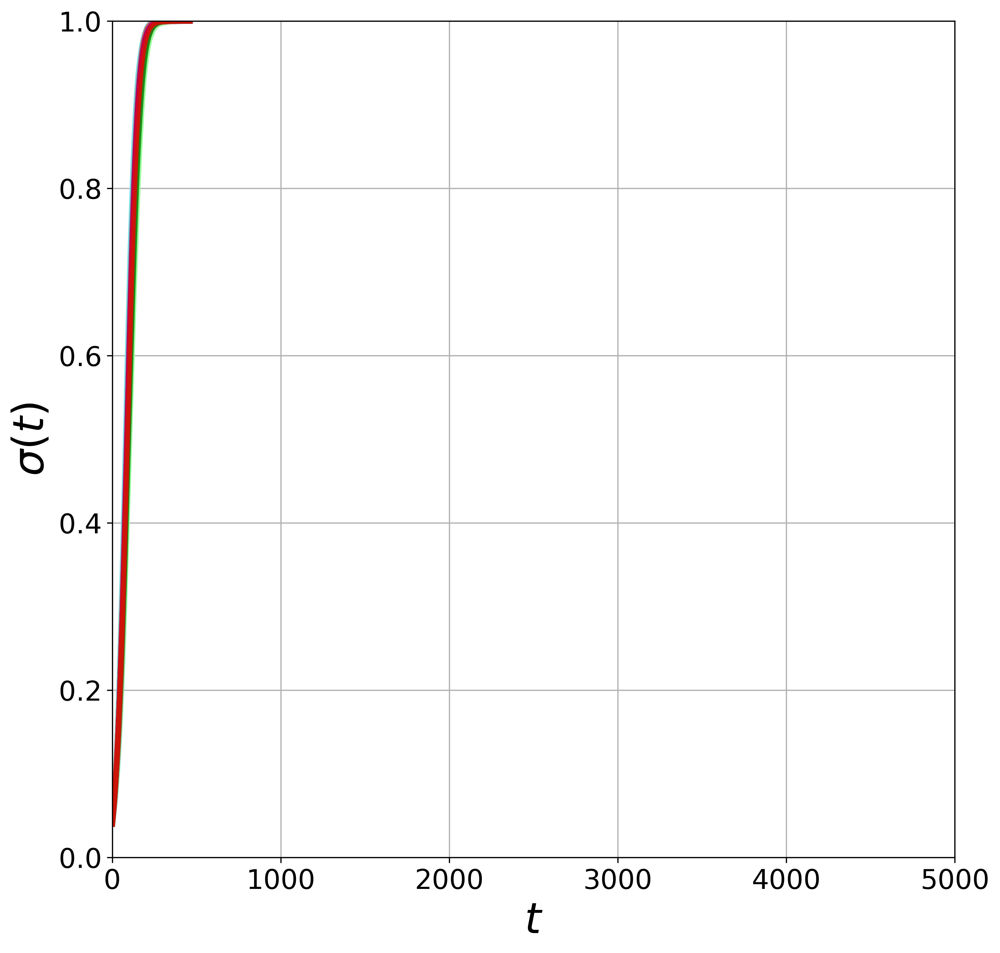

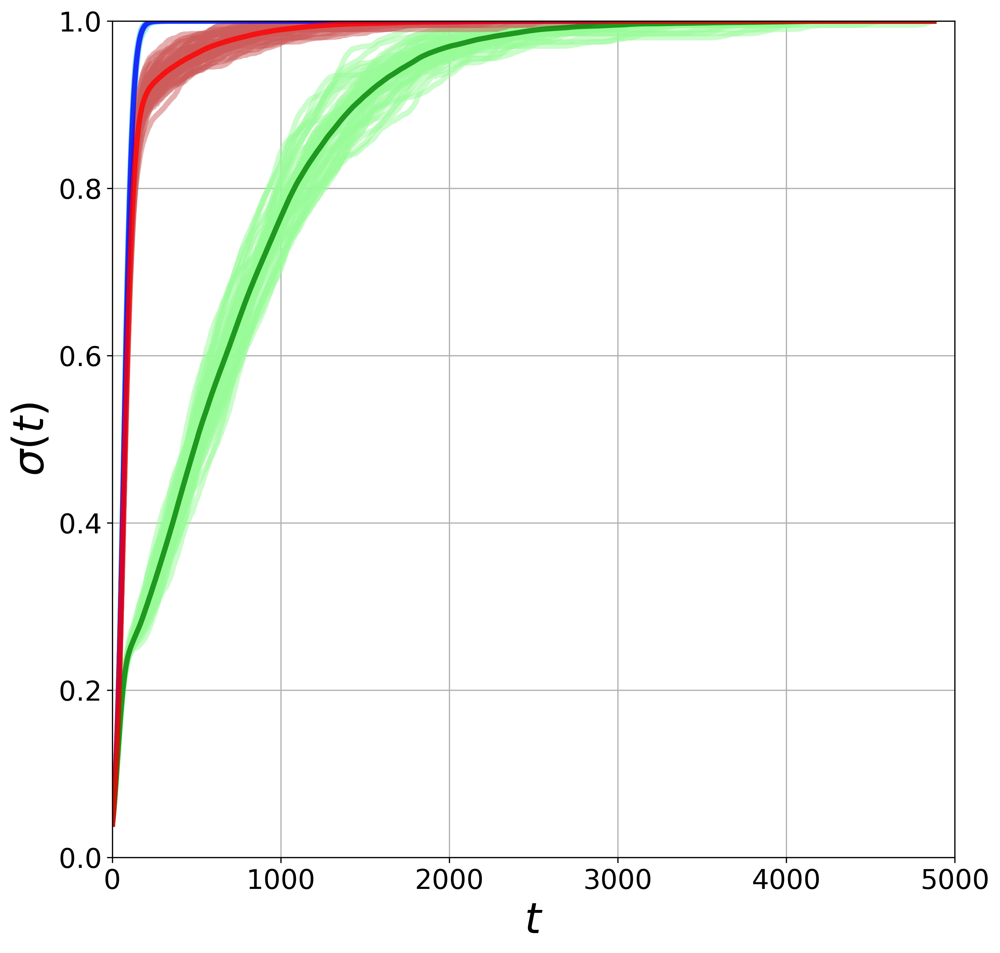

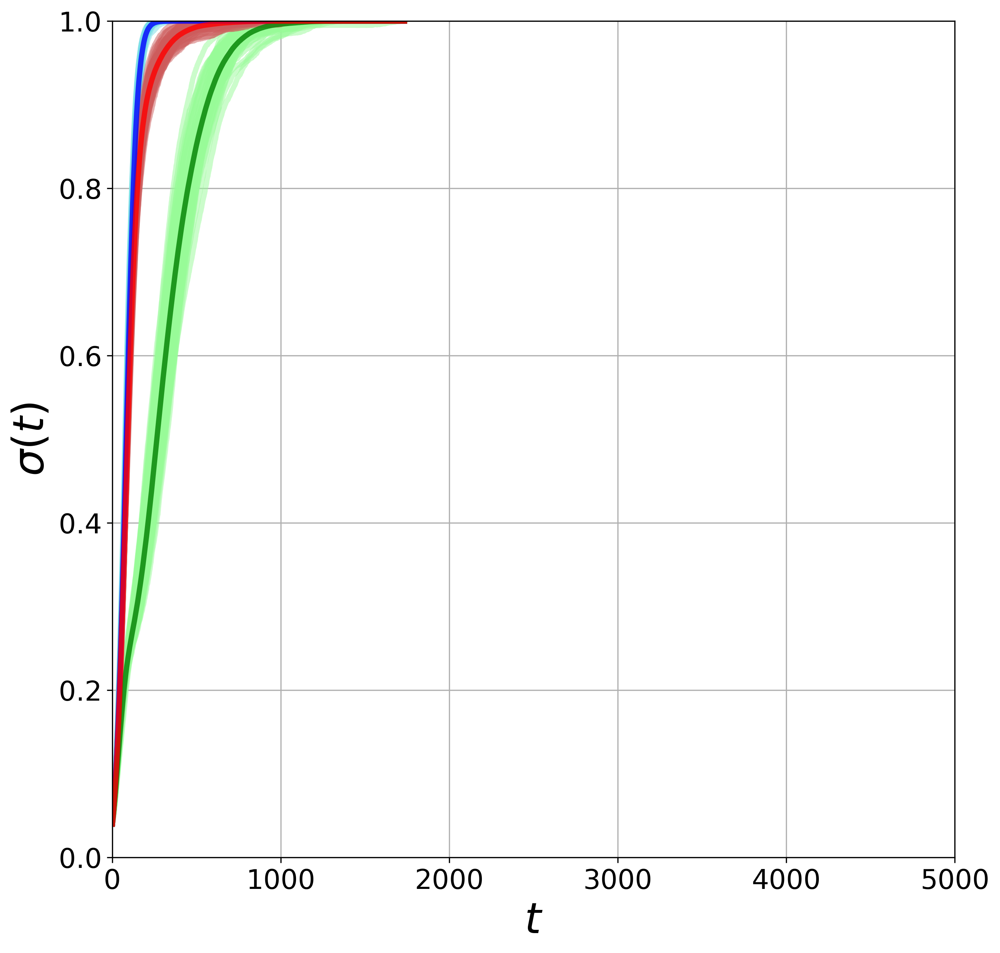

...

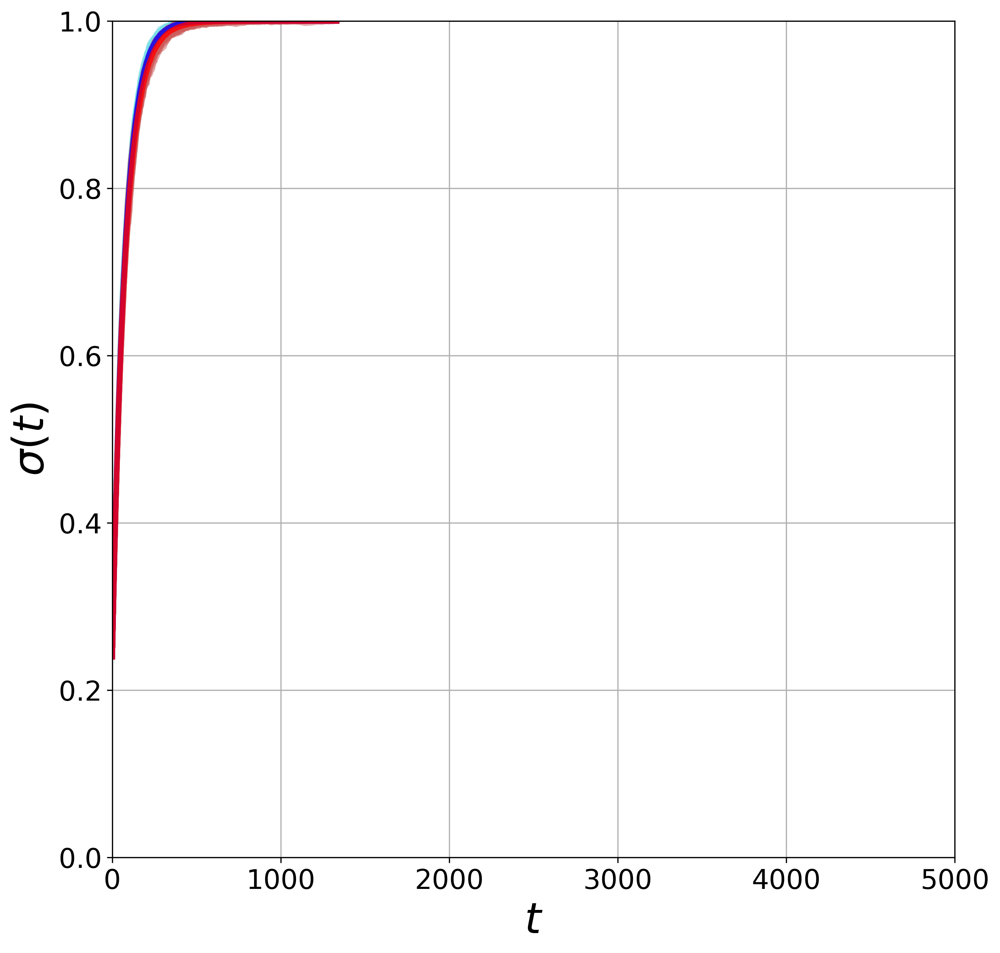

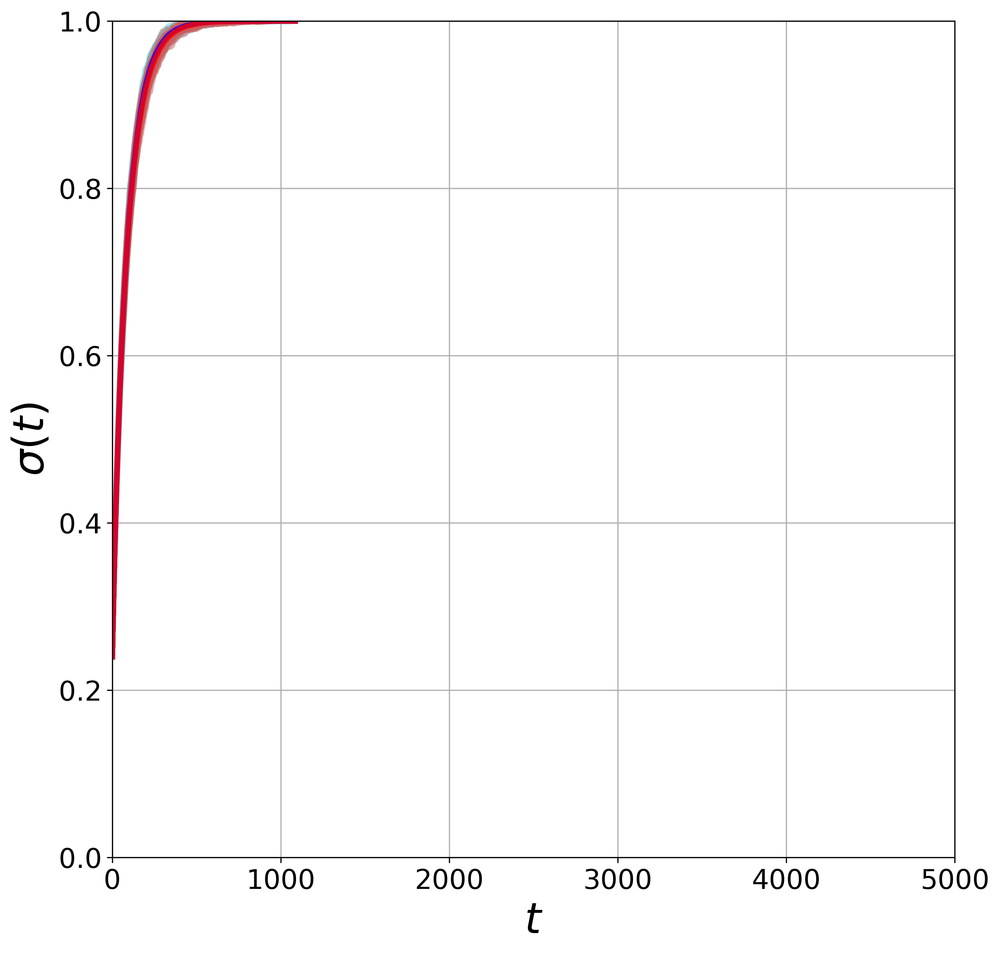

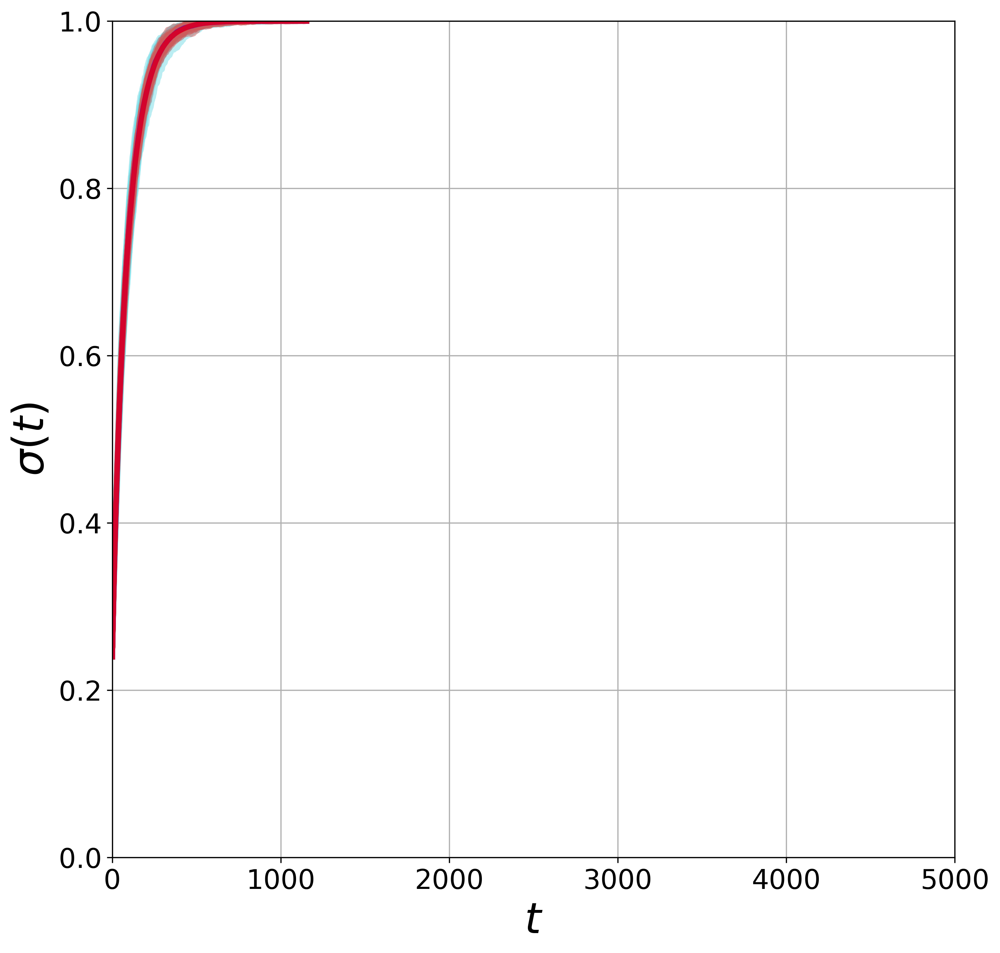

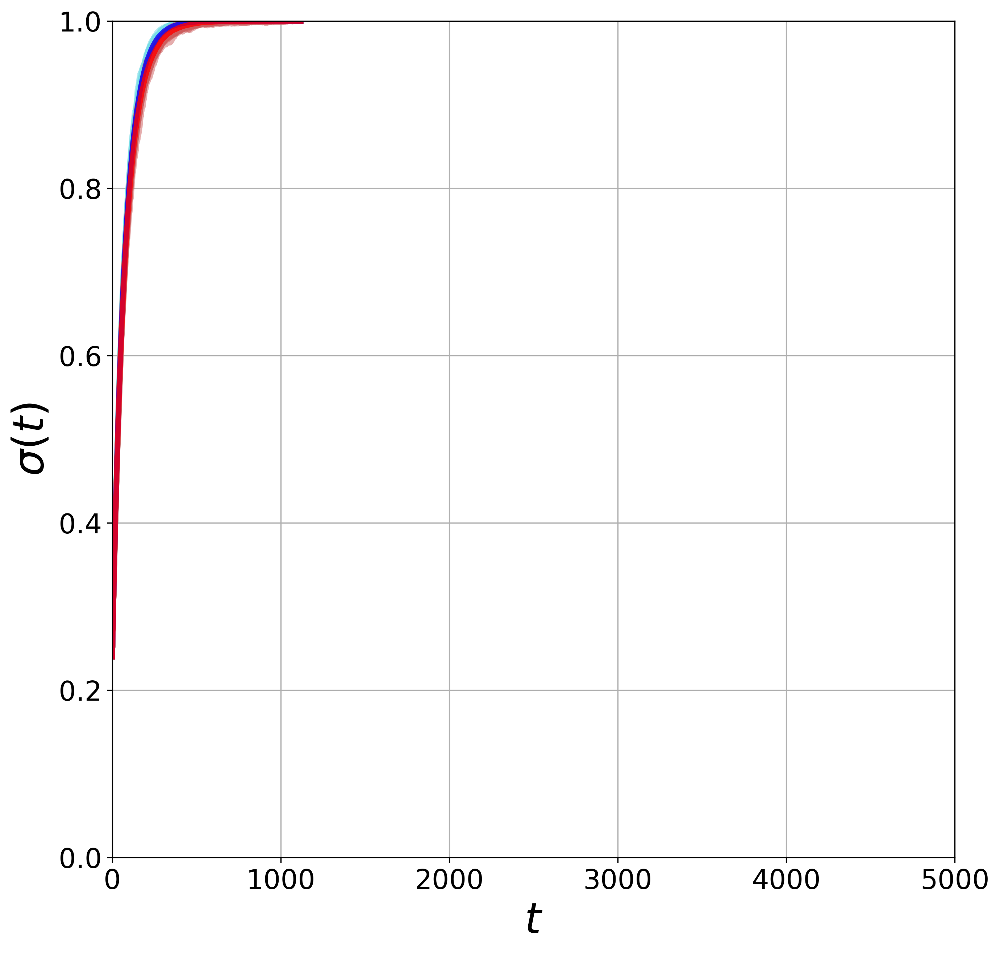

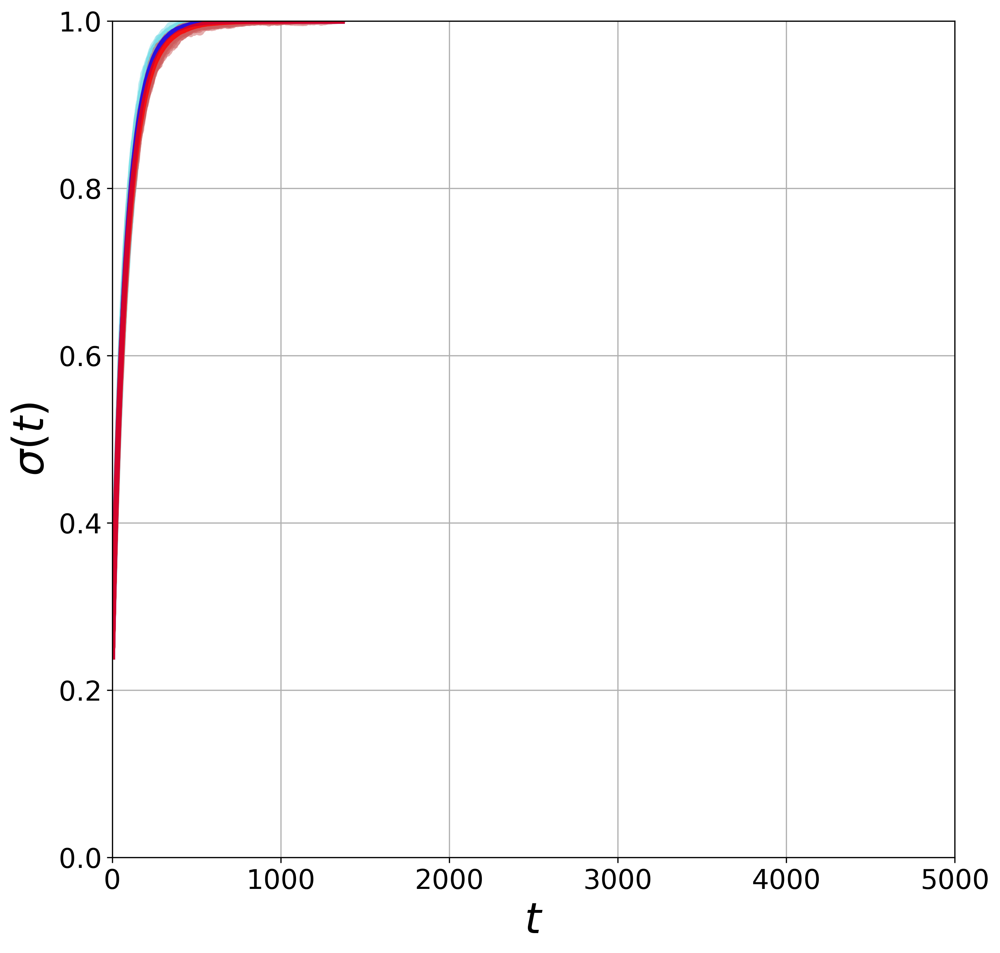

In [11]:
b0s = [0.055]

b1s = [0.01, 0.05, 0.055]

count_verts = [
    [8, 20, 28, 40, 48],
    [8, 20, 28, 40, 48],
    [8, 16, 24]
]

num_runs = 50

color_my = {
    DistributionType.randFix: 'red',
    DistributionType.fixedOneCluster: 'green',
    DistributionType.fixedAllCluster: 'blue'
}

color_sim = {
    DistributionType.randFix: '#CD5C5C',
    DistributionType.fixedOneCluster: '#98FB98',
    DistributionType.fixedAllCluster: '#77DDE7'
}

label_my = {
    DistributionType.randFix: 'Случайно в графе',
    DistributionType.fixedOneCluster: 'в одном городе',
    DistributionType.fixedAllCluster: 'во всех городах поровну'
}

statics = [
    True
]

func_types = [
    FunctionType.linear
]

x_right = {
    FunctionType.linear: 2500
}


graph_types_arr = [
[
    GraphType.roc,
    GraphType.ringClusters,
    GraphType.twoLevelEr,
    GraphType.cliqueOfCliques,
    GraphType.ringRings
],
[
    GraphType.ringClusters,
    GraphType.twoLevelEr,
    GraphType.ringRings
],
[
    GraphType.roc,
    GraphType.ringClusters,
    GraphType.cliqueOfCliques,
    GraphType.ringRings
]
]

x_right_static = [800, 5000]

for cur in range(1):
    for b0 in b0s:
        for b1 in b1s:
            for count_vert in count_verts[cur]:
                for ind in range(count_sim, count_sim + (1 * have_merge)):
                    path = f"{cur + 3}//n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}"
                    
                    if (ind != count_sim):
                        path_dir = path + f"//ind_{ind}"
                    else:
                        path_dir = path + f"//merge"
                    

                    sdb = SimulationDatabase(path='output//' + path_dir)
                    for static in statics:
                        for func_type in func_types:
                            for graph_type in graph_types_arr[cur]:
                                
                                sdirs = [
                                    sdir
                                    for sdir in sdb.sdirs
                                    if (sdir.sim.func_type == func_type) and
                                    (static is isinstance(sdir.sim, StaticSimulation)) and
                                    (sdir.sim.graph.graph_type != GraphType.complete) and
                                    (sdir.sim.graph.graph_type == graph_type)
                                ]
                                
                                if len(sdirs) != 2 and len(sdirs) != 3:
                                    raise RuntimeError(f"Expected 2 or 3 SimulationDirectories after filter, got {len(sdirs)}.")
                                sim = sdirs[0].sim
                                
                                fname = f"{sim.graph.graph_type}_b0={sim.beta_0}_b1={sim.beta_1}"
                                
                                if (sim.graph.graph_type == GraphType.twoLevelEr):
                                    fname += f"_p={sim.graph.probability_1}_q={sim.graph.probability_2}"
                                elif (sim.graph.graph_type == GraphType.roc):
                                    fname += f"_n_cliq={sim.graph.num_cliques}_cliq_s={sim.graph.clique_size}"
                                elif (sim.graph.graph_type == GraphType.ringClusters):
                                    fname += f"_clus_s={sim.graph.num_nodes_cluster}_n_clus={sim.graph.num_clusters}_p={sim.graph.probability}"
                                elif (sim.graph.graph_type == GraphType.ringRings):
                                    fname += f"_clus_s={sim.graph.num_nodes_cluster}_n_clus={sim.graph.num_clusters}_p={sim.graph.probability}"
                                elif (sim.graph.graph_type == GraphType.ringRings):
                                    fname += f"_cliq_s_1={sim.graph.clique_size_1}_cliq_s_2={sim.graph.clique_size_2}"
                    
                                if isinstance(sim, FixedSimulation) or isinstance(sim, RandFixSimulation):
                                    fname += f"_count_static={sim.count_vert}"
                                fname += "_static" * static + ".png"
                                
                                print(f"{fname}:")
                                splot = SigmaPlot(linewidth=3.5, alpha=.8, ax_tick_size=18, ax_label_size=28)
                                
                                gc.collect()
                                
                                for sdir in sdirs:
                                    print(f'caching {sdir}...')
                                    sdir.cache()
                                print()
                                x_max = max([sdir.t_max for sdir in sdirs])

                                for sdir in sdirs:
                                    sdir.cache()
                                    
                                    tmp = [sdir.state_histories[50 * j: 50 * (j + 1)] for j in range(50)]
                                    
                                    for state in tmp:
                                        sigma_avg = sigma_mean(state, pad_to=x_max)
                                        
                                        splot.ax.plot(
                                            range(len(sigma_avg)),
                                            sigma_avg,
                                            color=color_sim[sdir.sim.distribution_type],
                                            alpha=0.5,
                                            linewidth=splot.linewidth,
                                            ls=splot.linestyle,
                                            label=label_my[sdir.sim.distribution_type]
                                        )
                                
                                for sdir in sdirs:
                                    splot.plot(sdir, color=color_my[sdir.sim.distribution_type], x_max=x_max, label=label_my[sdir.sim.distribution_type])

                                if not os.path.isdir('plots\\' + path_dir + "new\\"):
                                    os.makedirs('plots\\' + path_dir + "new\\", exist_ok=True)
                                    
                                for x_right in x_right_static:  
                                    splot.update_axlims(x_right=x_right)
                                        
                                    # save
                                    splot.fig.savefig(
                                        os.path.join('plots\\' + path_dir + "new\\", f"({x_right})" + fname),
                                        bbox_inches='tight',
                                        pad_inches=0
                                    )

## Draw hist

3//n=200 st_n=8 b0=0.055_b1=0.01
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
3//n=200 st_n=20 b0=0.055_b1=0.01
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50


C:\Users\Admin\AppData\Local\Temp\ipykernel_21360\4181460201.py:106: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 1, sharey=True, tight_layout=True)


3//n=200 st_n=28 b0=0.055_b1=0.01
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
3//n=200 st_n=40 b0=0.055_b1=0.01
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
3//n=200 st_n=48 b0=0.055_b1=0.01
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
3//n=200 st_n=8 b0=0.055_b1=0.05
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
3//n=200 st_n=20 b0=0.055_b1=0.05
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
3//n=200 st_n=28 b0=0.055_b1=0.05
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34

KeyboardInterrupt: 

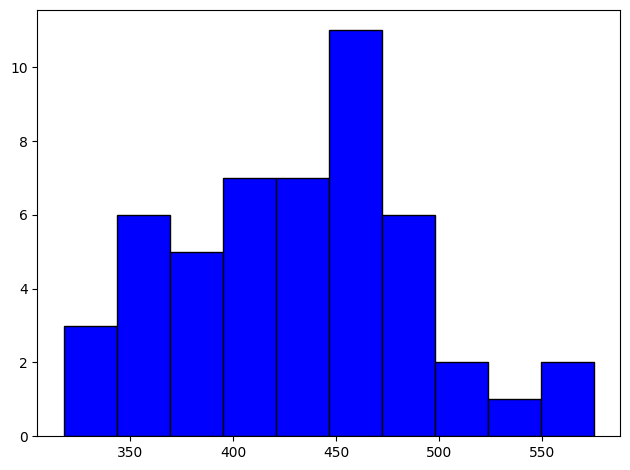

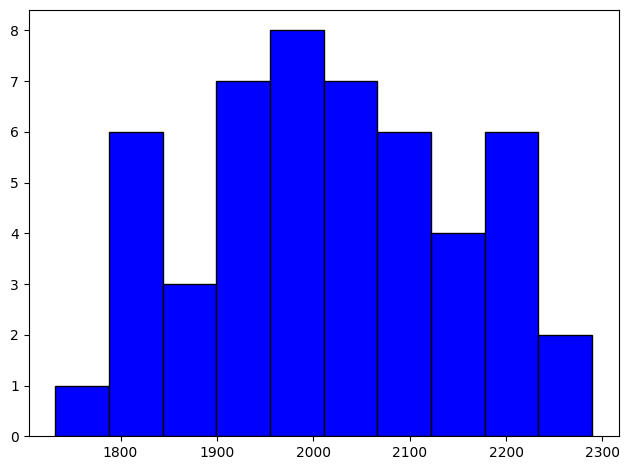

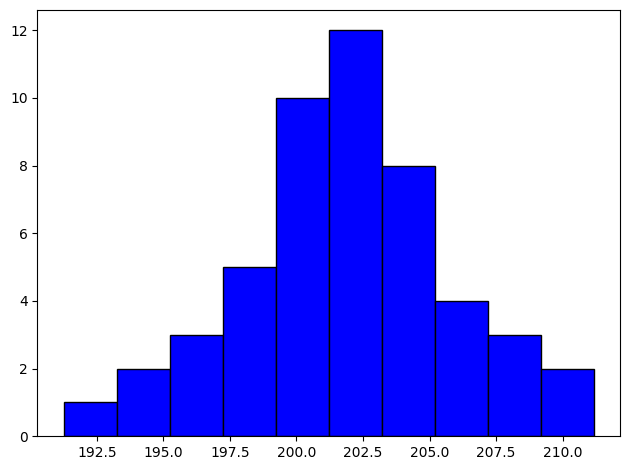

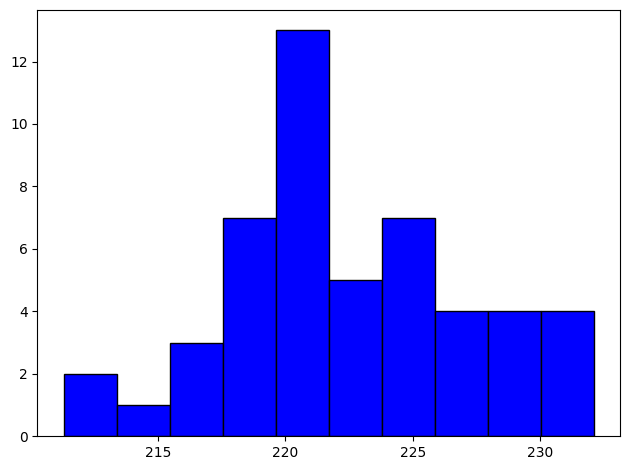

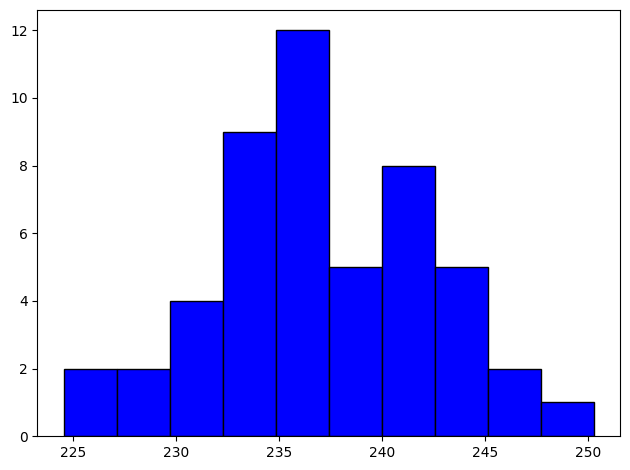

...

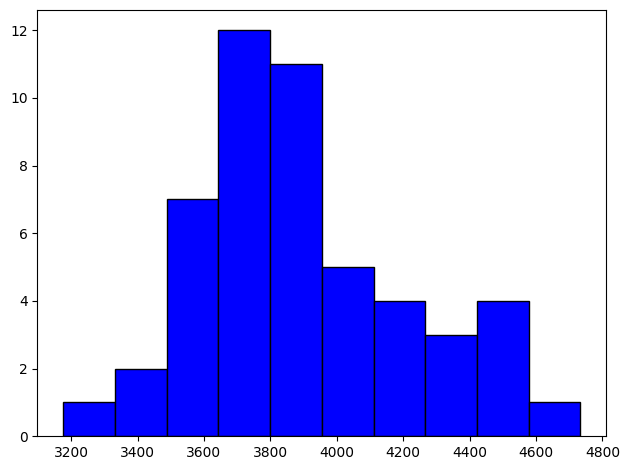

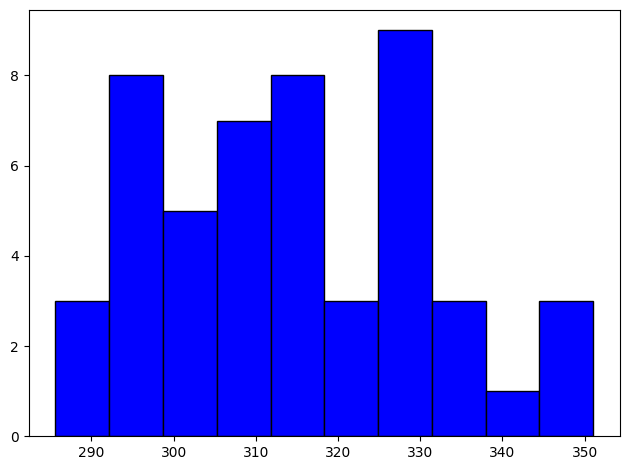

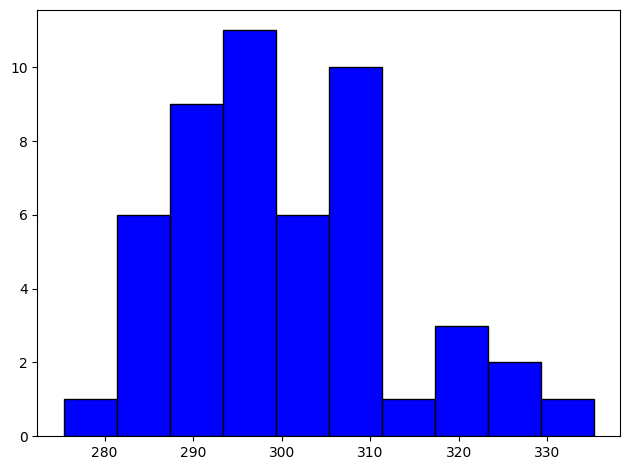

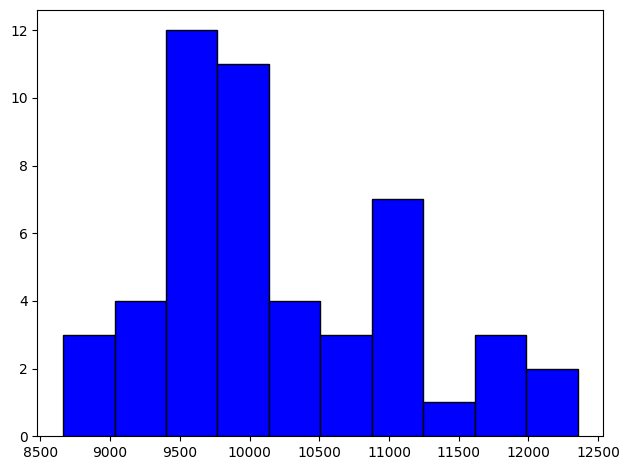

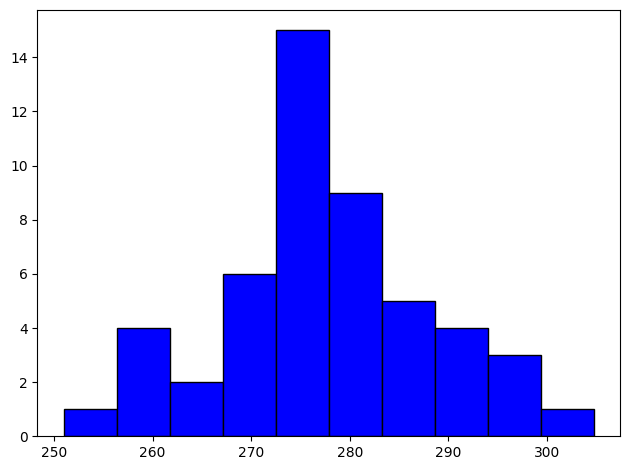

In [14]:
graphs_arr = [
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 10, 'clique_size': 50}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.03, 'probability_2': 0.001}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 10, 'clique_size_2': 50, "rand": False}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 50, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.3}),
    (GraphType.twoLevelEr): (TwoLevelErGraph, {'num_nodes_cluster': 250, 'probability_1': 0.3, 'probability_2': 0.01}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 50, 'num_clusters': 10, 'probability': 0.3}),
},
{
    # (GraphType.complete): (CompleteGraph, {'num_nodes': num_nodes}),
    (GraphType.roc): (RocGraph, {'num_cliques': 20, 'clique_size': 25}),
    (GraphType.ringClusters): (RingGraphClusters, {'num_nodes_cluster': 25, 'num_clusters': 20, 'random_nodes': True, 'probability': 0.1}),
    (GraphType.ringRings): (RingRingsGraph, {'num_nodes_cluster': 25, 'num_clusters': 20, 'probability': 0.1}),
    (GraphType.cliqueOfCliques): (CliqueOfCliquesGraph, {'clique_size_1': 20, 'clique_size_2': 25, "rand": False}),
}
]

b0s = [0.055]
b1s = [0.01, 0.05, 0.055]
# b1s = [0.055, 0.057]
count_verts = [
    [8, 20, 28, 40, 48],
    [8, 20, 28, 40, 48],
    [8, 16, 24]
]

for cur in range(1):
    
    
    for b0 in b0s:   
        for b1 in b1s: 
            for count_vert in count_verts[cur]:
                
                path_dir_cur = f"{cur + 3}//n={num_nodes} st_n={count_vert} b0={b0}_b1={b1}"
                print(path_dir_cur)
                g = {}
                for (graph_type), (_, graph_params) in graphs_arr[cur].items():    
                    for (func_type, distribution_type, static), _ in simulations_arr[cur].items():
                        g[(func_type, distribution_type, graph_type, static)] = []
                
                for ind in range(count_sim):
                    print(ind + 1)
                    
                    path_dir = "output//" + path_dir_cur
                    
                    path_dir += f"//ind_{ind}"

                    
                    sdb = SimulationDatabase(path=path_dir)
                    
                    for (graph_type), (_, graph_params) in graphs_arr[cur].items():    
                        for (func_type, distribution_type, static), _ in simulations_arr[cur].items():
                            
                            if (b1 >= 0.055 and distribution_type == DistributionType.fixedOneCluster):
                                continue
                            
                            sdirs = [
                                sdir
                                for sdir in sdb.sdirs
                                if (sdir.sim.func_type == func_type) and
                                (sdir.sim.distribution_type == distribution_type) and
                                (static is isinstance(sdir.sim, StaticSimulation)) and
                                (sdir.sim.graph.graph_type == graph_type)
                            ]
                            
                            if len(sdirs) != 1:
                                raise RuntimeError(f"Found {len(sdirs)} SimulationDirectories after filter. Expected over 1.")
                            
                            sdir = sdirs[0]
                            
                            sdir.cache()
                            # sdir.info()
                            
                            g[(sdir.sim.func_type, sdir.sim.distribution_type, sdir.sim.graph.graph_type, static)].append(sdir.t_mean_1)
                            
                            del sdir
                            
                            gc.collect()
                
                for (graph_type), (_, graph_params) in graphs_arr[cur].items():    
                    for (func_type, distribution_type, static), _ in simulations_arr[cur].items():
                        fname = f"{distribution_type}_{graph_type}_b0={b0}_b1={b1}"
                                
                        if (graph_type == GraphType.twoLevelEr):
                            fname += f"_p={graph_params["probability_1"]}_q={graph_params["probability_2"]}"
                        elif (graph_type == GraphType.roc):
                            fname += f"_n_cliq={graph_params["num_cliques"]}_cliq_s={graph_params["clique_size"]}"
                        elif (graph_type == GraphType.ringClusters):
                            fname += f"_clus_s={graph_params["num_nodes_cluster"]}_n_clus={graph_params["num_clusters"]}_p={graph_params["probability"]}"
                        elif (graph_type == GraphType.ringRings):
                            fname += f"_clus_s={graph_params["num_nodes_cluster"]}_n_clus={graph_params["num_clusters"]}_p={graph_params["probability"]}"
                        elif (graph_type == GraphType.ringRings):
                            fname += f"_cliq_s_1={graph_params["clique_size_1"]}_cliq_s_2={graph_params["clique_size_2"]}"
            
                        fname += f"_count_static={count_vert}"
                        
                        fname += "_static" * static + ".png"
                        
                        fig, axs = plt.subplots(1, 1, sharey=True, tight_layout=True)
                        axs.hist(g[(func_type, distribution_type, graph_type, static)], color = 'blue', edgecolor = 'black', bins = count_sim // 5)
                        if not os.path.isdir('plots\\hists\\' + path_dir_cur):
                            os.makedirs('plots\\hists\\' + path_dir_cur, exist_ok=True)
                            
                        fig.savefig(os.path.join('plots\\hists\\' + path_dir_cur, fname),
                                    bbox_inches='tight',
                                    pad_inches=0)
                        
    print(f"{cur}-----------------------------------------------------{cur}")

## Display

In [ ]:
display(splot.fig)

## Save

In [32]:
splot.fig.savefig(
    os.path.join('plots', fname),
    bbox_inches='tight',
    pad_inches=0
)

## Animate

In [16]:
sdir = SimulationDirectory("output\\test_test\\2024.05.17_03.00.50_longstep_randfix_ringclusters(n=500,m=10,p=0.1)_(count_vert=10)_static")
sr = read_pickled('1', path=sdir.path)
animate(
    sdir.sim,
    sr,
    filename='test1',
    path=sdir.path,
    t_start=max(0, 0),
    t_end=sr.t,
    overwrite=True
)
print(sr.t)

Converting fig2img: 100%|██████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 28.96it/s]


37


## Test Graphs

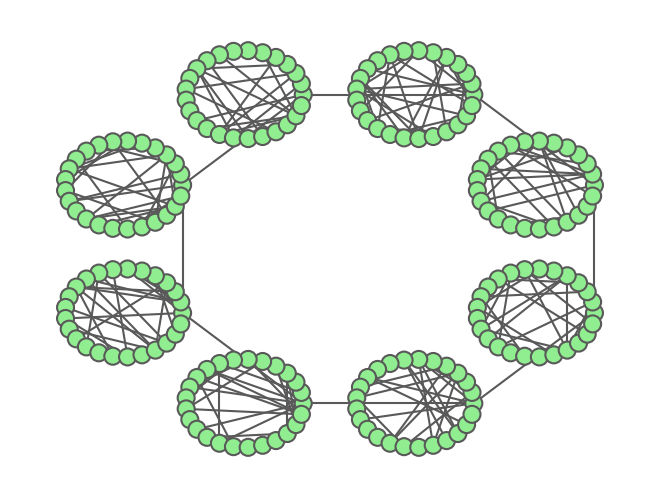

In [3]:
import networkx as nx
from config import nxdraw, COLOR_0
from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph

g = RingRingsGraph(25, 8, 0.1)

col = [COLOR_0 for _ in range(4 * 50)]
nx.draw(g.graph, g.layout, node_color=col, **nxdraw)


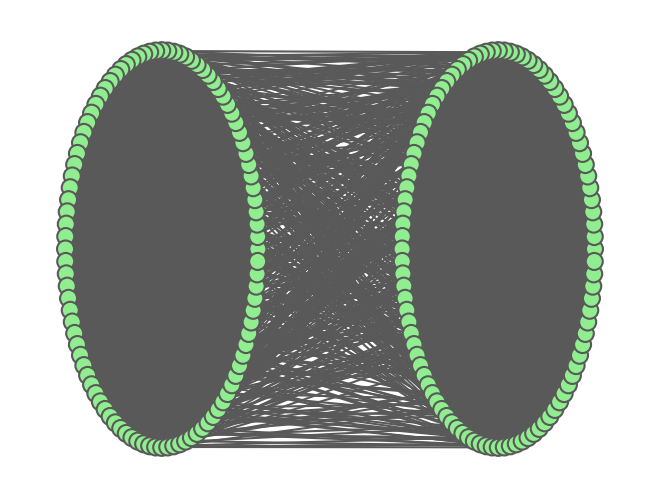

In [12]:
import networkx as nx
from config import nxdraw, COLOR_0
from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph

g = TwoLevelErGraph(100, 0.5, 0.05)

col = [COLOR_0 for _ in range(100 * 2)]

nx.draw(g.graph, g.layout, node_color=col, **nxdraw)

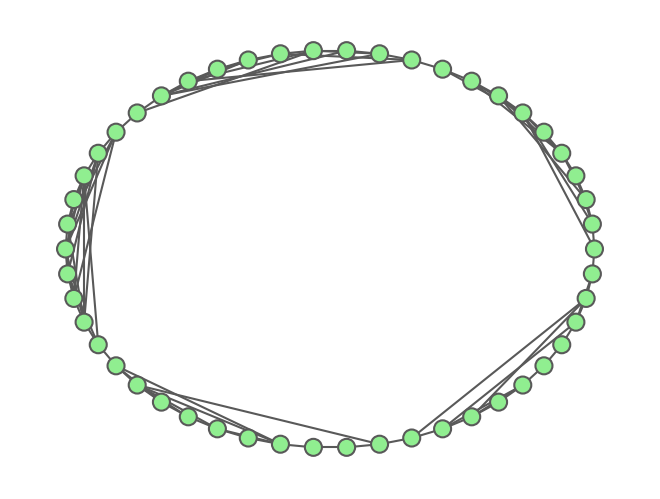

In [24]:
import networkx as nx
from config import nxdraw, COLOR_1
from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph

# (GraphType.roc, 460): (RocGraph, {'num_cliques': 10, 'clique_size': 10}),
#     (GraphType.ringClusters, 360): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.6}),
#     #(GraphType.ringClusters, 150): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'num_edges_cluster': 5}),
#     (GraphType.twoLevelEr, 370): (TwoLevelErGraph, {'num_nodes_cluster': 50, 'probability_1': 0.1, 'probability_2': 0.05}),
#     (GraphType.ringRings,  280): (RingRingsGraph, {'num_nodes_cluster': 10, 'num_clusters': 10, 'probability': 0.5}),

g = RingGraphClusters(num_nodes_cluster=50, num_clusters=5, random_nodes=False, probability=0.3)

col = [0 for _ in range(10*5)]

nx.draw(g.graph, g.layout, node_color=col, **nxdraw)

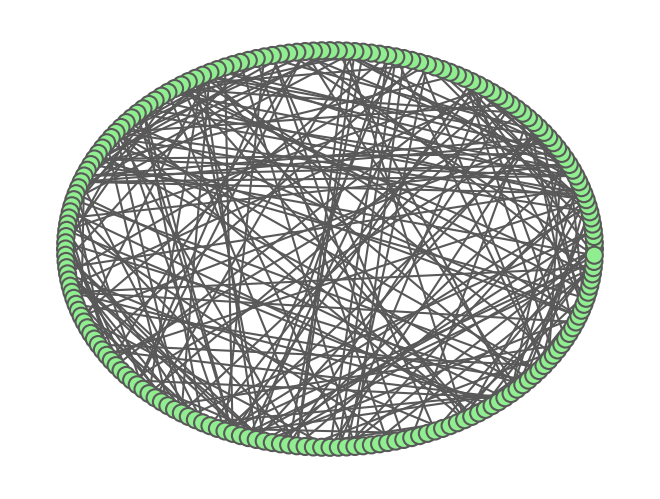

In [7]:
import networkx as nx
from config import nxdraw, COLOR_0
from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph

# (GraphType.roc, 460): (RocGraph, {'num_cliques': 10, 'clique_size': 10}),
#     (GraphType.ringClusters, 360): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.6}),
#     #(GraphType.ringClusters, 150): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'num_edges_cluster': 5}),
#     (GraphType.twoLevelEr, 370): (TwoLevelErGraph, {'num_nodes_cluster': 50, 'probability_1': 0.1, 'probability_2': 0.05}),
#     (GraphType.ringRings,  280): (RingRingsGraph, {'num_nodes_cluster': 10, 'num_clusters': 10, 'probability': 0.5}),

g = RingGraphClusters(num_nodes_cluster=25, num_clusters=8, random_nodes=True, probability=0.1)

col = [COLOR_0 for _ in range(50*4)]

nx.draw(g.graph, g.layout, node_color=col, **nxdraw)

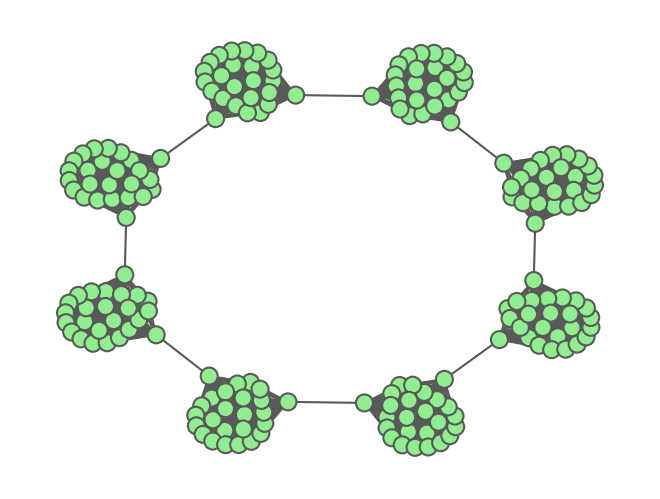

In [10]:
import networkx as nx
from config import nxdraw, COLOR_0
from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph, CliqueOfCliquesGraph

# (GraphType.roc, 460): (RocGraph, {'num_cliques': 10, 'clique_size': 10}),
#     (GraphType.ringClusters, 360): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'probability': 0.6}),
#     #(GraphType.ringClusters, 150): (RingGraphClusters, {'num_nodes_cluster': 10, 'num_clusters': 10, 'random_nodes': True, 'num_edges_cluster': 5}),
#     (GraphType.twoLevelEr, 370): (TwoLevelErGraph, {'num_nodes_cluster': 50, 'probability_1': 0.1, 'probability_2': 0.05}),
#     (GraphType.ringRings,  280): (RingRingsGraph, {'num_nodes_cluster': 10, 'num_clusters': 10, 'probability': 0.5}),

g = RocGraph(num_cliques=8, clique_size=25)

col = [COLOR_0 for _ in range(4*50)]
nx.draw(g.graph, g.layout, node_color=col, **nxdraw)

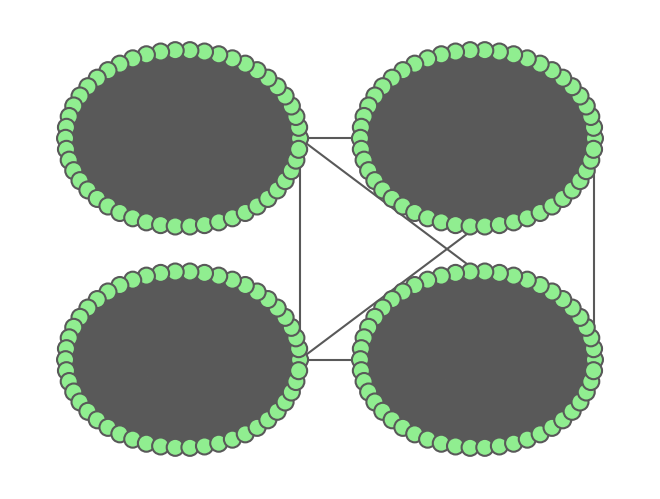

In [3]:
import networkx as nx
from config import nxdraw, COLOR_0
from graph import GraphType, RocGraph, RingGraphClusters, TwoLevelErGraph, RingRingsGraph, CliqueOfCliquesGraph


g = CliqueOfCliquesGraph(clique_size_1=4, clique_size_2=50, rand=False)

col = [COLOR_0 for _ in range(50*4)]
nx.draw(g.graph, g.layout, node_color=col, **nxdraw)

In [139]:
from utils import merge_sim

merge_sim(["output"], "longstep_randfix_twoleveler(n=500,p=0.024,q=0.001)_(count_vert=10)_static"        , "output//merge_new_new")
merge_sim(["output"], "longstep_fixedonecluster_twoleveler(n=500,p=0.024,q=0.001)_(count_vert=10)_static", "output//merge_new_new")
merge_sim(["output"], "longstep_fixedallcluster_twoleveler(n=500,p=0.024,q=0.001)_(count_vert=10)_static", "output//merge_new_new")
merge_sim(["output"], "longstep_randfix_ringclusters(n=500,m=10,p=0.1)_(count_vert=10)_static"          , "output//merge_new_new")
merge_sim(["output"], "longstep_fixedonecluster_ringclusters(n=500,m=10,p=0.1)_(count_vert=10)_static"  , "output//merge_new_new")
merge_sim(["output"], "longstep_fixedallcluster_ringclusters(n=500,m=10,p=0.1)_(count_vert=10)_static"  , "output//merge_new_new")

In [ ]:
sdb = SimulationDatabase(path="output\\3\\n=200 st_n=8 b0=0.055_b1=0.01\\merge")
